<img src="http://www.exalumnos.usm.cl/wp-content/uploads/2015/06/Isotipo-Negro.gif" title="Title text" width="20%" height="20%" />


<hr style="height:2px;border:none"/>
<h1 align='center'> Binary Variational Semantic Hashing </h1>

<H3 align='center'> Extensión trabajo CIARP </H3>
<hr style="height:2px;border:none"/>

In [1]:
import numpy as np
import keras,gc, os, time, sys
from keras.layers import *
from keras.models import Sequential,Model
from keras import backend as K
from astropy.table import Table
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from PIL import Image
from scipy.special import expit

from base_networks import *
from utils import check_availability, load_imgs_mask

from utils import get_topK_labels,set_newlabel_list, enmask_data

np.random.seed(20)

/home/fmena/anaconda3/envs/tesis/lib/python3.5/site-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.
/home/fmena/.local/lib/python3.5/site-packages/tensorflow/python/framework/dtypes.py:469: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/fmena/.local/lib/python3.5/site-packages/tensorflow/python/framework/dtypes.py:470: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/fmena/.local/lib/python3.5/site-package

## Load Data

### MNIST
---

Imágenes en blanco y negro de 28x28 píxeles, de números del 0 al 9, que dan orígen a las 10 clases del problema.

|Tipo set|Datos|Label|
|---|---|---|
|Entrenamiento|60000|10|
|Pruebas|10000|10|

In [2]:
name_dat = "MNIST"

(X_t, aux_t), (X_test, aux_test) = keras.datasets.mnist.load_data()
X_t = np.expand_dims(X_t, axis=-1)
X_test = np.expand_dims(X_test, axis=-1)

labels = ["0", "1", "2", "3", "4", "5", "6", "7", "8", "9"]
labels_t = np.asarray([labels[value] for value in aux_t])
labels_test = np.asarray([labels[value] for value in aux_test])
print("Datos de entrenamiento: ",len(X_t))
print("Datos de pruebas: ",len(X_test))

Datos de entrenamiento:  60000
Datos de pruebas:  10000


In [3]:
##concat all
X_t = np.concatenate((X_t,X_test),axis=0)
labels_t = np.concatenate((labels_t,labels_test),axis=0)
del X_test, labels_test
gc.collect()

##### 1000 imagenes de prueba... 
from utils import sample_test_mask
mask_train = sample_test_mask(labels_t, N=100, multi_label=False)

In [4]:
## creat test como dicen...
X_test = X_t[~mask_train]
X_t = X_t[mask_train]
labels_test = enmask_data(labels_t, ~mask_train)
labels_t = enmask_data(labels_t, mask_train)

gc.collect()
print("Cantidad de datos Entrenamiento: ",len(X_t))
print("Cantidad de datos Pruebas: ",len(X_test))

Cantidad de datos Entrenamiento:  69000
Cantidad de datos Pruebas:  1000


### CIFAR-10
---
Imágenes RGB pequeñas de  32x32 píxeles, de fotos naturales de distintos objetos.

|Tipo set|Datos|Label|
|---|---|---|
|Entrenamiento|50000|10|
|Pruebas|10000|10|

In [4]:
name_dat = "CIFAR-10"

(X_t, aux_t), (X_test, aux_test) = keras.datasets.cifar10.load_data()

labels = ["airplane", "automobile","bird", "cat","deer","dog","frog","horse","ship","truck"]
labels_t = np.asarray([labels[value[0]] for value in aux_t])
labels_test = np.asarray([labels[value[0]] for value in aux_test])
print("Datos de entrenamiento: ",len(X_t))
print("Datos de pruebas: ",len(X_test))

Datos de entrenamiento:  50000
Datos de pruebas:  10000


In [5]:
##concat all
X_t = np.concatenate((X_t,X_test),axis=0)
labels_t = np.concatenate((labels_t,labels_test),axis=0)
del X_test, labels_test
gc.collect()

##### 1000 imagenes de prueba... 
from utils import sample_test_mask
mask_train = sample_test_mask(labels_t, N=100, multi_label=False)

In [6]:
## creat test como dicen...
X_test = X_t[~mask_train]
X_t = X_t[mask_train]
labels_test = enmask_data(labels_t, ~mask_train)
labels_t = enmask_data(labels_t, mask_train)

gc.collect()
print("Cantidad de datos Entrenamiento: ",len(X_t))
print("Cantidad de datos Pruebas: ",len(X_test))

Cantidad de datos Entrenamiento:  59000
Cantidad de datos Pruebas:  1000


### CelebA
---
* Cantidad de datos totales: 202599
* Datos en plataforma Kaggle:https://www.kaggle.com/jessicali9530/celeba-dataset 

Imágenes RGB re-dimensionadas a 64x64 píxeles, de fotos naturales de rostros de celebridades. Una muestra es utilizada

|Tipo set|Datos|Label|
|---|---|---|
|Entrenamiento|xxx|40|
|Validación|xxx|40|
|Pruebas|xxx|40|

mask_av = check_availability(folder+"small_images/", labels_t)
np.savetxt("./Data/+"name_dat+"_mask_avail.txt", mask_av, fmt="%1i")

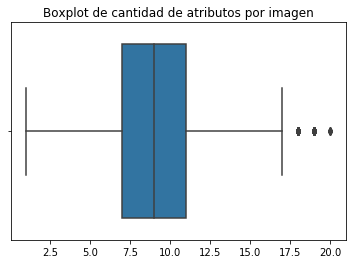

In [3]:
sns.boxplot(list(map(len,labels_t)))
plt.title("Boxplot de cantidad de topics por imagen")
plt.show()

In [10]:
name_dat = "CelebA"
mask_av = np.loadtxt("./Data/"+name_dat+"_mask_avail.txt").astype(bool)

folder = "../CelebA/"

part = pd.read_csv(folder+"list_eval_partition.csv")
mask_train = (part["partition"].values == 0)[mask_av]
mask_val = (part["partition"].values == 1)[mask_av]
mask_test = (part["partition"].values == 2)[mask_av]

df_atrr = pd.read_csv(folder+"list_attr_celeba.csv")[mask_av]
img_names = df_atrr["image_id"].values
labels = list(df_atrr.columns[1:])
print("Cantidad de labels: ",len(labels) )

N_total = len(df_atrr)
print("Cantidad de objetos: ",N_total )
aux = (df_atrr == 1).values
labels_t = np.asarray([list(df_atrr.columns[aux[value]]) for value in range(N_total)])
labels[:5]

Cantidad de labels:  40
Cantidad de objetos:  202599


['5_o_Clock_Shadow',
 'Arched_Eyebrows',
 'Attractive',
 'Bags_Under_Eyes',
 'Bald']

In [11]:
mask_used= np.ones(N_total, dtype=bool)

N_used = 80*1000 #o 150k??
idx_all = np.arange(0, N_total)
mask_used = np.zeros(N_total, dtype=bool)
mask_used[np.random.choice(np.arange(0, N_total), size=N_used, replace=False)] = 1
mask_used

#### get top-K labels data
* Elije 6, para realizar un enfoque mas centrado: http://openaccess.thecvf.com/content_cvpr_2017/papers/Shen_Learning_Residual_Images_CVPR_2017_paper.pdf:
* Elije 7: https://arxiv.org/pdf/1804.08882.pdf

In [4]:
new_labels = get_topK_labels(labels_t, labels, K=??)

labels_t = set_newlabel_list(new_labels, labels_t)
labels = new_labels
# y si quedan datos sin clase?
mask_used_t = np.asarray(list(map(len,labels_t))) != 0
print("Cantidad de objetos: ", np.sum(mask_used_t) )

sns.boxplot(list(map(len,labels_t)))
plt.title("Boxplot de cantidad de topics por imagen")
plt.show()

mask_used = mask_used_t

SyntaxError: invalid syntax (<ipython-input-4-0c039559b924>, line 1)

In [12]:
imgs_files = [folder+ "imgs_celebA/"+ name for name in img_names]

X_t = load_imgs_mask(imgs_files, mask_used, size=64) #images names to load
X_t.shape

El contador de lectura va en:  0
El contador de lectura va en:  10000
El contador de lectura va en:  20000
El contador de lectura va en:  30000
El contador de lectura va en:  40000
El contador de lectura va en:  50000
El contador de lectura va en:  60000
El contador de lectura va en:  70000
El contador de lectura va en:  80000
El contador de lectura va en:  90000
El contador de lectura va en:  100000
El contador de lectura va en:  110000
El contador de lectura va en:  120000
El contador de lectura va en:  130000
El contador de lectura va en:  140000
El contador de lectura va en:  150000
El contador de lectura va en:  160000
El contador de lectura va en:  170000
El contador de lectura va en:  180000
El contador de lectura va en:  190000
El contador de lectura va en:  200000


(202599, 64, 64, 3)

In [13]:
from utils import sample_test_mask
mask_train = sample_test_mask(labels_t, N=100, multi_label=True)

## creat test como dicen...
X_test = X_t[~mask_train]
X_t = X_t[mask_train]
labels_test = enmask_data(labels_t, ~mask_train)
labels_t = enmask_data(labels_t, mask_train)

gc.collect()
print("Cantidad de datos Entrenamiento: ",len(X_t))
print("Cantidad de datos Pruebas: ",len(X_test))

Cantidad de datos Entrenamiento:  198599
Cantidad de datos Pruebas:  4000


#create sets 
X_t = X_t.astype('float32')/255.
X_train = X_t[mask_train[mask_used]]
X_val = X_t[mask_val[mask_used]]
X_test = X_t[mask_test[mask_used]]

labels_train = enmask_data(labels_t, mask_train & mask_used)
labels_val = enmask_data(labels_t, mask_val & mask_used)
labels_test = enmask_data(labels_t, mask_test & mask_used)

del X_t,mask_train,mask_val,mask_test,mask_used
gc.collect()
print("Cantidad de datos Entrenamiento: ",len(X_train))
print("Cantidad de datos Validación: ",len(X_val))
print("Cantidad de datos Pruebas: ",len(X_test))

### NUSWIDE
---
* Cantidad de datos totales: 269648
* Datos utlizados (con imagenes disponibles a descargar): 169500
* Datos top-21 clases: 158383

Imágenes de eventos con 81 tópicos asociados, re-dimensionadas a 64x64.

|Tipo set|Datos|Label|
|---|---|---|
|Entrenamiento|xxx|81|
|Validación|xxx|81|
|Pruebas|xxx|81|

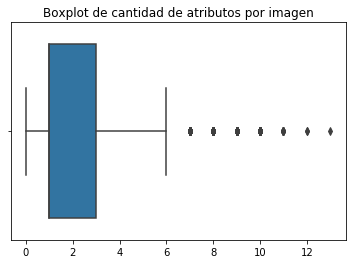

In [6]:
sns.boxplot(list(map(len,labels_t)))
plt.title("Boxplot de cantidad de atributos por imagen")
plt.show()

list_images = pd.read_csv(folder+"ImageList/Imagelist_downloaded.txt", header=None).iloc[:,0]
imgs_files = [value for value in list_images.values]

folder_imgs_name = folder+"small_images/"
mask_av = check_availability(folder_imgs_name, imgs_files, labels_t)
np.savetxt("./Data/"+name_dat+"_mask_avail.txt", mask_av, fmt="%1i")

mask_av

In [2]:
name_dat = "Nus-Wide"

folder = "../Dataset_NUSWIDE/"
folder_imgs_name = folder+"small_images/"

mask_av = np.loadtxt("./Data/"+name_dat+"_mask_avail.txt").astype(bool)

labels = pd.read_csv(folder+'Concepts81.txt',header=None).values.reshape(1,-1)[0]
print("Cantidad de labels: ",len(labels) )

labels_t = [[] for _ in range(269648)]
for concept in labels:
    aux = pd.read_csv(folder+"Groundtruth/AllLabels/Labels_"+concept+".txt",header=None)
    indexs_true = aux.loc[(aux==1).values[:,0]].index
    
    for value in indexs_true:
        labels_t[value].append(concept)
        
labels_t = enmask_data(labels_t, mask_av)
N_total = len(labels_t)
print("Cantidad de objetos: ",N_total )

labels_t[:5]

Cantidad de labels:  81
Cantidad de objetos:  169500


[['person'], ['person'], ['person'], ['person'], ['person']]

#### get top-K labels data

category with most data (sky) has = 61066, the top-K category (mountain) has = 4232
Cantidad de objetos:  158383


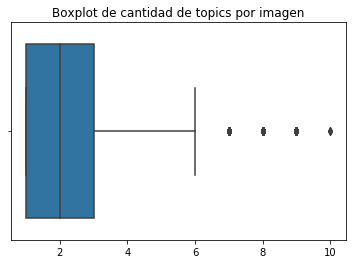

In [3]:
new_labels = get_topK_labels(labels_t, labels, K=21)

labels_t = set_newlabel_list(new_labels, labels_t)
labels = new_labels
# y si quedan datos sin clase?
mask_used_t = np.asarray(list(map(len,labels_t))) != 0

labels_t = enmask_data(labels_t, mask_used_t)
print("Cantidad de objetos: ", len(labels_t) )

sns.boxplot(list(map(len,labels_t)))
plt.title("Boxplot de cantidad de topics por imagen")
plt.show()

N_used = 80*1000 #o 150k??
idx_all = np.arange(0, N_total)
mask_used = np.zeros(N_total, dtype=bool)
mask_used[np.random.choice(np.arange(0, N_total), size=N_used, replace=False)] = 1
mask_used

In [4]:
list_images = pd.read_csv(folder+"ImageList/Imagelist_downloaded.txt", header=None).iloc[:,0]
imgs_files = [folder_imgs_name + value for value in list_images.values]
imgs_files = enmask_data(imgs_files, mask_av)

X_t = load_imgs_mask(imgs_files, mask_used_t, size=64) #images names to load
X_t.shape

El contador de lectura va en:  0
El contador de lectura va en:  10000
El contador de lectura va en:  20000
El contador de lectura va en:  30000
El contador de lectura va en:  40000
El contador de lectura va en:  50000
El contador de lectura va en:  60000
El contador de lectura va en:  70000
El contador de lectura va en:  80000
El contador de lectura va en:  90000
El contador de lectura va en:  100000
El contador de lectura va en:  110000
El contador de lectura va en:  120000
El contador de lectura va en:  130000
El contador de lectura va en:  140000
El contador de lectura va en:  150000
El contador de lectura va en:  160000


(158383, 64, 64, 3)

We sam-ple uniformly 100 images from each of the selected 21tags to form a query set of 2,100 images with the restserving as the training set. http://cfm.uestc.edu.cn/~fshen/SADH.pdf

In [5]:
mask_train = np.ones(len(X_t), dtype='bool')
mask_train[np.random.choice(np.arange(len(X_t)), size=10000, replace=False)] = 0

In [5]:
from utils import sample_test_mask
mask_train = sample_test_mask(labels_t, N=100, multi_label=True)

In [6]:
## creat test como dicen...
X_test = X_t[~mask_train]
X_t = X_t[mask_train]
labels_test = enmask_data(labels_t, ~mask_train)
labels_t = enmask_data(labels_t, mask_train)

gc.collect()
print("Cantidad de datos Entrenamiento: ",len(X_t))
print("Cantidad de datos Pruebas: ",len(X_test))

Cantidad de datos Entrenamiento:  156283
Cantidad de datos Pruebas:  2100


### Validation creation

Pre-process: División por 255

In [7]:
X_total = X_t.astype('float32')/255.0
X_test = X_test.astype('float32')/255.0
labels_total = labels_t

del X_t
gc.collect()

In [24]:
def show_reconstruct(X, model, low_error=False):
    n = 10
    
    X_hat = model.predict(X)
    idxs = np.arange(len(X))
    if low_error:
        error = np.mean(-X*np.log(X_hat) -(1-X)*np.log(1-X_hat), axis=(1,2,3))
        #values = np.argsort(error)[:n]
        #print(np.sort(error)[:n])
    

    if low_error:
        v = np.mean(error) - 2*np.std(error)
        n_sampleds = np.random.choice( idxs[error < v], size=n, replace=False)
    else:
        n_sampleds = np.random.choice( idxs, size=n, replace=False)
            
    plt.figure(figsize=(20, 4))
    for i,n_i in enumerate(n_sampleds):
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(np.squeeze(X[n_i]))
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        plt.title("Imagenes reales")

        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(np.squeeze(X_hat[n_i]))
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        plt.title("Reconstruccion")
    plt.show()

#### CIFAR

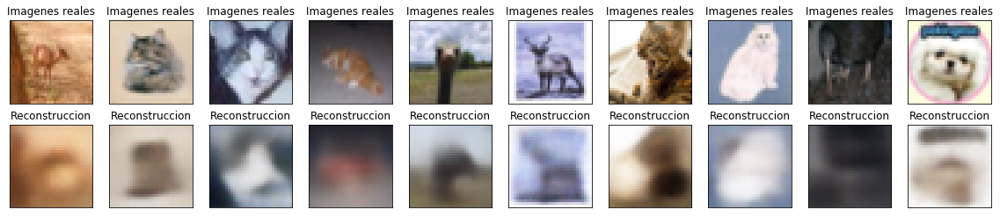

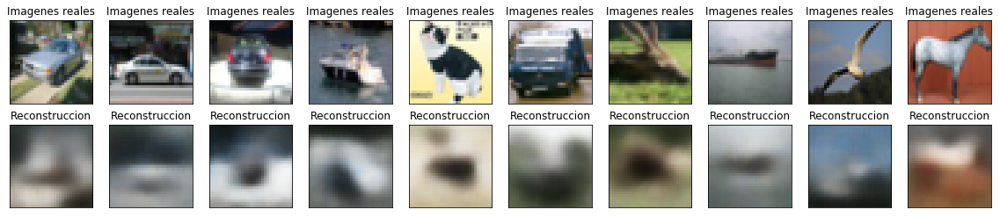

In [44]:
show_reconstruct(X_test, traditional_vae)

show_reconstruct(X_test, binary_vae)

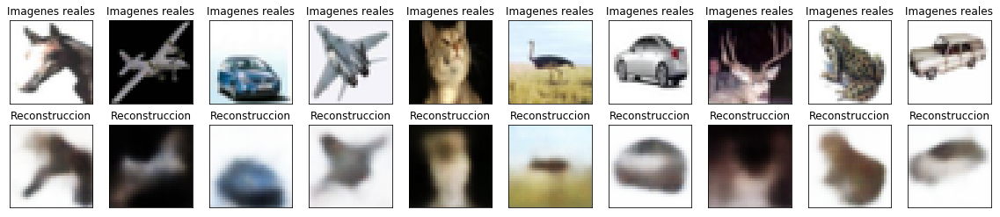

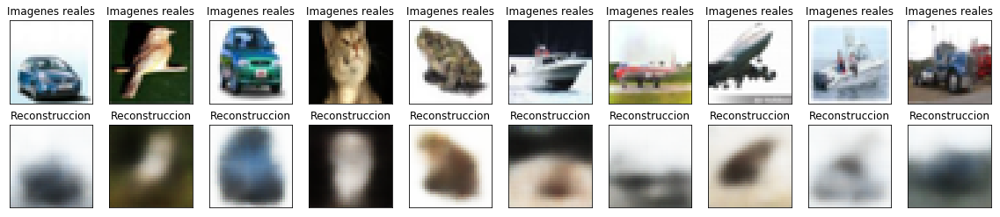

In [45]:
## show low error-images
show_reconstruct(X_test, traditional_vae, low_error=True)

show_reconstruct(X_test, binary_vae, low_error=True)

#### CELEBA

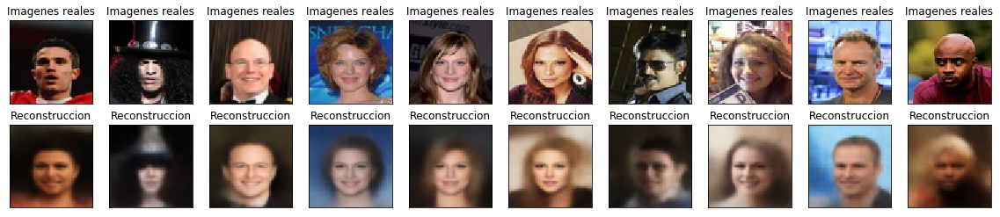

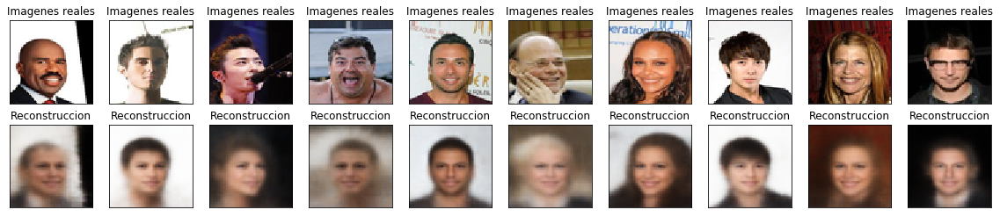

In [17]:
show_reconstruct(X_test, traditional_vae)

show_reconstruct(X_test, binary_vae)

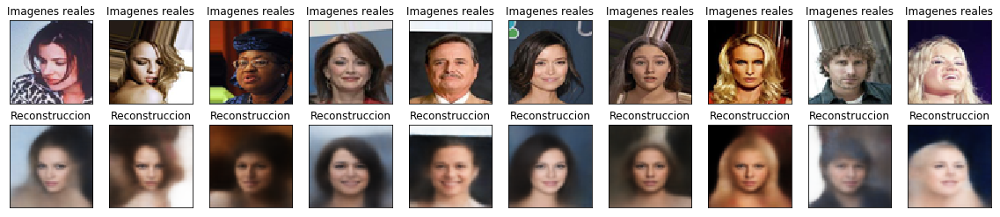

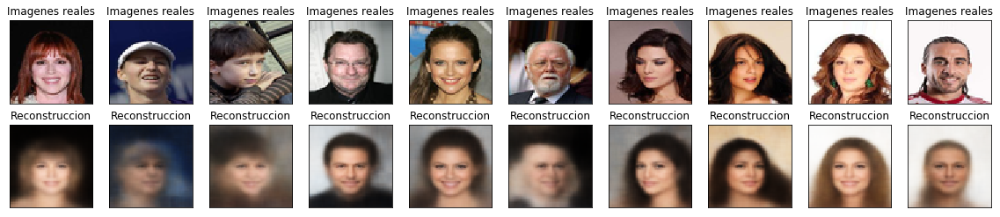

In [25]:
## kernel de 5 
show_reconstruct(X_test, traditional_vae)

show_reconstruct(X_test, binary_vae)

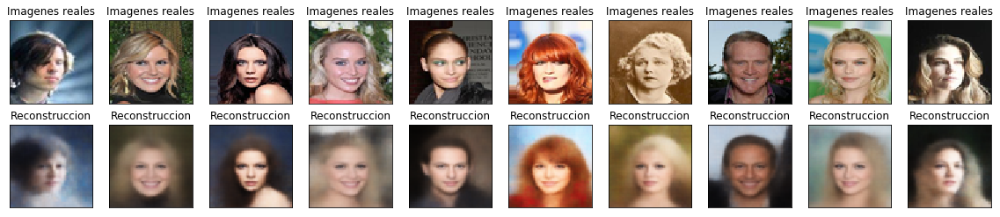

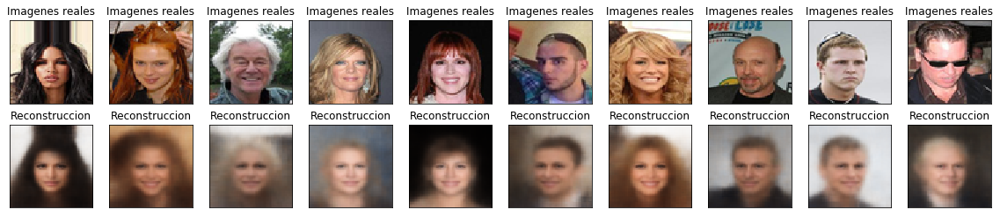

In [33]:
## units 64
show_reconstruct(X_test, traditional_vae)

show_reconstruct(X_test, binary_vae)

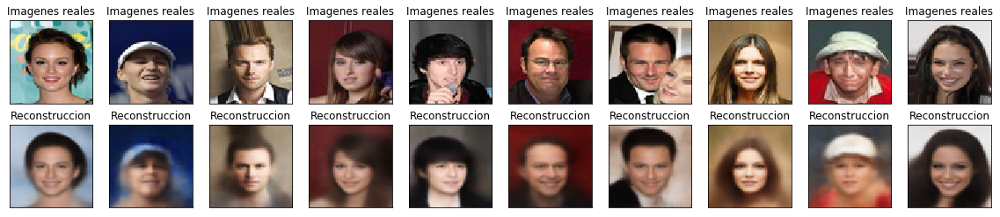

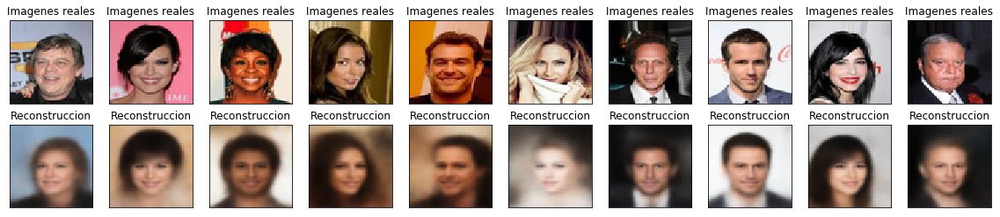

In [40]:
## dense
show_reconstruct(X_test, traditional_vae)

show_reconstruct(X_test, binary_vae)

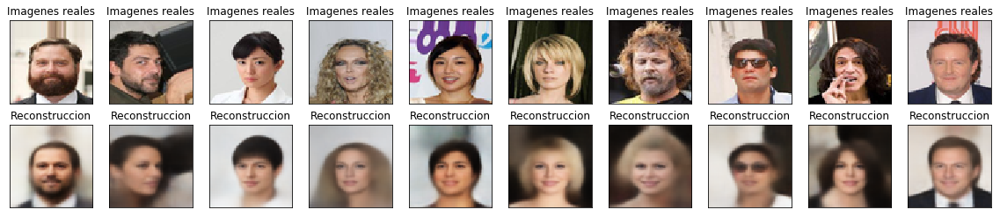

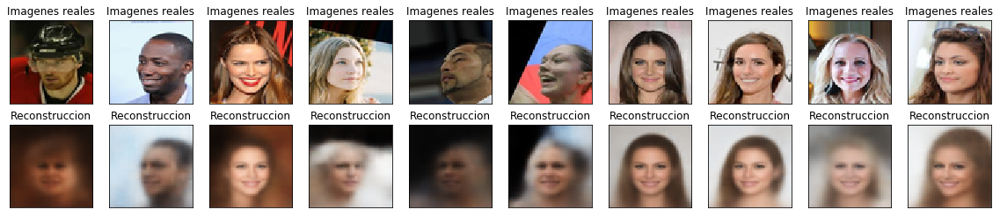

In [47]:
## 5 y 4 capas
show_reconstruct(X_test, traditional_vae)

show_reconstruct(X_test, binary_vae)

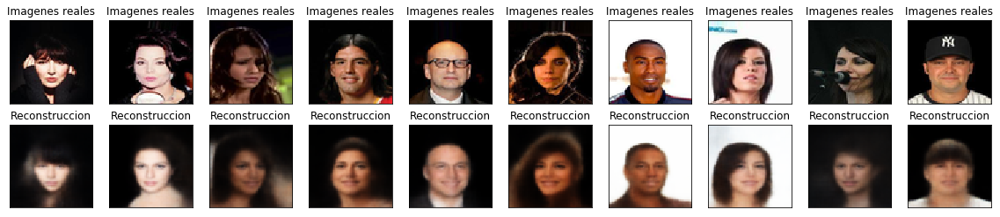

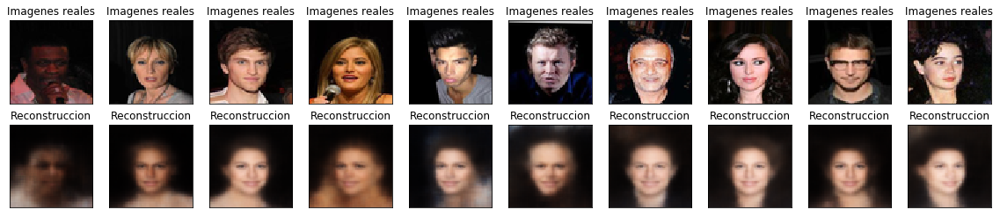

In [54]:
## show low error-images
show_reconstruct(X_test, traditional_vae, low_error=True)

show_reconstruct(X_test, binary_vae, low_error=True)

#### NUSWIDE

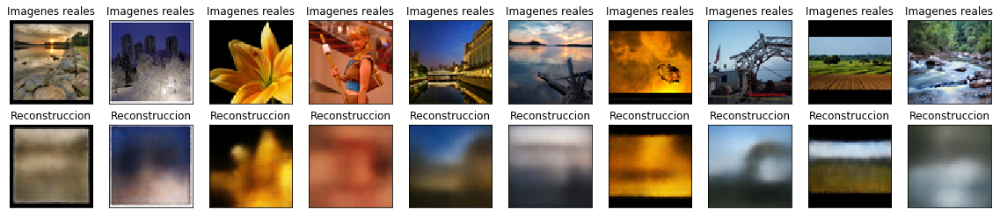

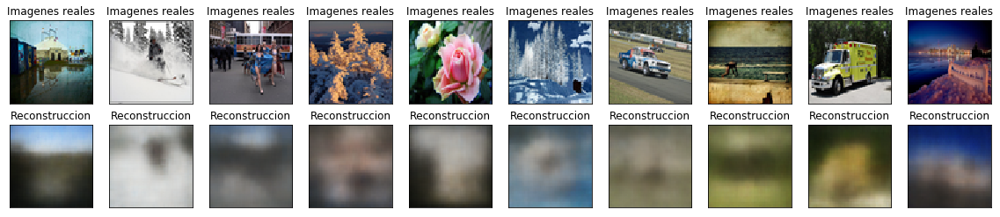

In [20]:
show_reconstruct(X_test, traditional_vae)

show_reconstruct(X_test, binary_vae)

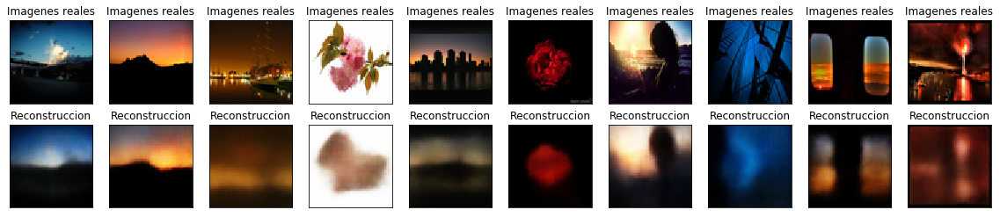

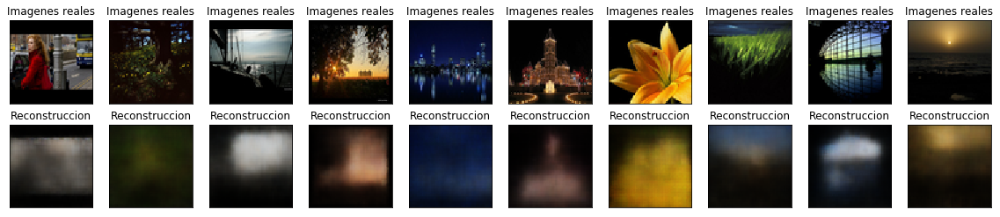

In [21]:
## show low error-images
show_reconstruct(X_test, traditional_vae, low_error=True)

show_reconstruct(X_test, binary_vae, low_error=True)

# Analysis / Intepretability
---


In [52]:
def calculate_hash(data,model):
    encode_data = model.predict(data) #logits
    #para Binary VAE
    probas_data = expit(encode_data)
    data_hash = (probas_data > 0.5)*1
    return data_hash

from utils import compare_cells_plot
BITS_S = 32

In [53]:
encoder_Bvae = keras.models.load_model("saved_models/"+name_dat+"_BVAE_"+str(BITS_S)+"b_E_defaultCNN.h5")

Nb = encoder_Bvae.output_shape[1]

train_hash = calculate_hash(X_total, encoder_Bvae)
test_hash = calculate_hash(X_test, encoder_Bvae)

/home/fmena/.local/lib/python3.5/site-packages/keras/models.py:251: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


In [21]:
from sklearn.manifold import TSNE
n = 3000 #data to train
model = TSNE(n_components=2, metric='hamming', init= "random", n_jobs=-1)
train_plot =  model.fit_transform(train_hash[:n])

MNIST


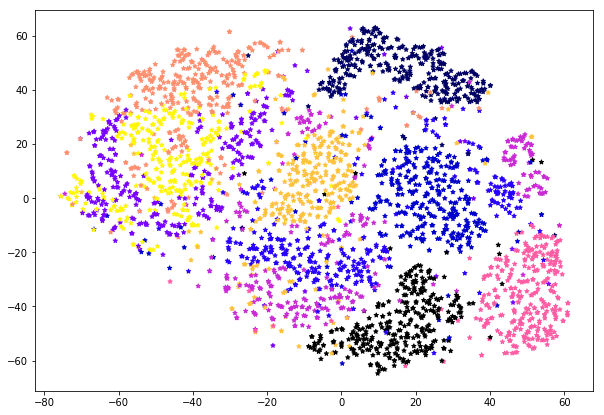

In [163]:
print(name_dat)
colors_plot = np.asarray([plt.cm.gnuplot2(i/C_train.shape[1],1) for i in range(C_train.shape[1])]) #labels??
plt.figure(figsize=(10,7))
plt.scatter(train_plot[:,0],train_plot[:,1],c=colors_plot[C_train[:n].argmax(axis=1)],marker="*",s=20) 
plt.show()

CIFAR-10


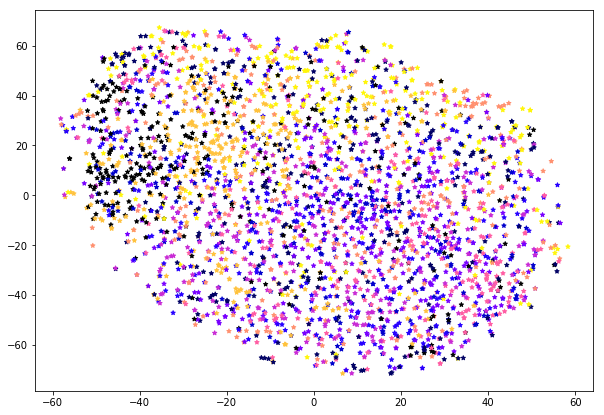

In [52]:
print(name_dat)
colors_plot = np.asarray([plt.cm.gnuplot2(i/C_train.shape[1],1) for i in range(C_train.shape[1])]) #labels??
plt.figure(figsize=(10,7))
plt.scatter(train_plot[:,0],train_plot[:,1],c=colors_plot[C_train[:n].argmax(axis=1)],marker="*",s=20) 
plt.show()

In [22]:
print(name_dat)
colors_plot = np.asarray([plt.cm.gnuplot2(i/C_train.shape[1],1) for i in range(C_train.shape[1])]) #labels??
plt.figure(figsize=(10,7))
plt.scatter(train_plot[:,0],train_plot[:,1],c=colors_plot[C_train[:n].argmax(axis=1)],marker="*",s=20) 
plt.show()

Nus-Wide


NameError: name 'C_train' is not defined

In [ ]:
encoder_Tvae = keras.models.load_model("saved_models/"+name_dat+"_VAE_"+str(BITS_S)+"b_E_defaultCNN.h5")

encode_total = encoder_Tvae.predict(X_total)
encode_test = encoder_Tvae.predict(X_test)
median= MedianHashing()
median.fit(encode_total)
train_hash2 = median.transform(encode_total)
test_hash2 = median.transform(encode_test)
del encode_total, encode_test
gc.collect()

Cantidad de memorias en tabla hash:  4294967296
Entrenamiento----
Cantidad de datos a llenar la tabla hash:  50000
Cantidad de memorias ocupadas hash1:  49686
Cantidad de memorias ocupadas hash2:  49953


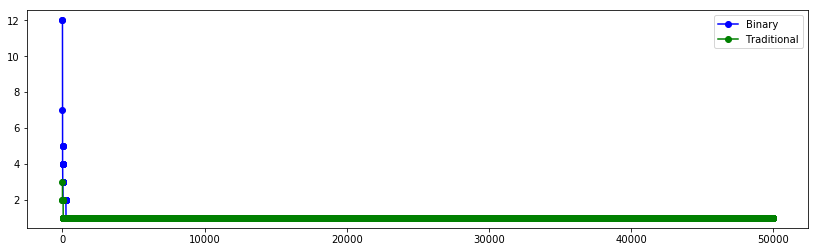

Pruebas-----
Cantidad de datos a llenar la tabla hash:  10000
Cantidad de memorias ocupadas hash1:  9986
Cantidad de memorias ocupadas hash2:  9996


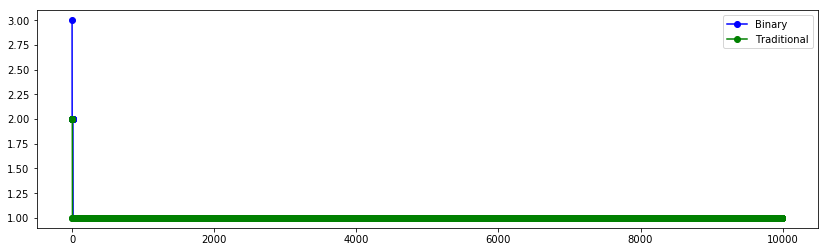

In [53]:
#plot together -- 32 bits
compare_cells_plot(Nb,train_hash,train_hash2,test_hash,test_hash2)

Se puede ver que se ocupan varias celdas de memorias gracias a la restricción de las variables latentes en el VAE, donde en la mayoría de los casos se asigna una única dirección de memoria para un objeto, obteniendo una tabla *hashing* distribuidamente poblada.  

> Y si se varía el número de bits?

In [47]:
#plot together--8 bits
print("Cantidad de memorias en tabla hash: ",2**Nb)
compare_cells_plot(Nb,train_hash,train_hash2,test_hash,test_hash2)

Cantidad de memorias en tabla hash:  4294967296


NameError: name 'Nb' is not defined

In [ ]:
#plot together--8 bits
encode_total = encoder_Tvae.predict(X_total)
encode_test = encoder_Tvae.predict(X_test)
median= MedianHashing()
median.fit(encode_total)
train_hash2 = median.transform(encode_total)
test_hash2 = median.transform(encode_test)
del encode_total, encode_test
gc.collect()

print("Cantidad de memorias en tabla hash: ",2**Nb)
compare_cells_plot(Nb,train_hash,train_hash2,test_hash,test_hash2)

In [ ]:
#plot together--- 4 bits
encode_total = encoder_Tvae.predict(X_total)
encode_test = encoder_Tvae.predict(X_test)
median= MedianHashing()
median.fit(encode_total)
train_hash2 = median.transform(encode_total)
test_hash2 = median.transform(encode_test)
del encode_total, encode_test
gc.collect()

print("Cantidad de memorias en tabla hash: ",2**Nb)
compare_cells_plot(Nb,train_hash,train_hash2,test_hash,test_hash2)

In [54]:
idx_class = {}
for value in np.arange(len(labels_total)):
    for tag in labels_total[value]:
        if tag in idx_class:
            idx_class[tag].append(value)
        else:
            idx_class[tag] = [value]

In [55]:
def clone_generator_net(BITS=32):
    aux_model = keras.models.clone_model(aux_G, input_tensors=Input(shape=(BITS,)))
    aux_model.layers.pop(1) #remove old layers
    return aux_model

generator_Bvae = clone_generator_net(32)
generator_Bvae.load_weights("saved_models/"+name_dat+"_BVAE_"+str(BITS_S)+"b_D_defaultCNN_w.h5")

generator_Bvae.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_13 (InputLayer)        (None, 32)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 8192)              270336    
_________________________________________________________________
reshape_2 (Reshape)          (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_transpose_4 (Conv2DTr (None, 16, 16, 128)       147584    
_________________________________________________________________
conv2d_transpose_5 (Conv2DTr (None, 32, 32, 64)        73792     
_________________________________________________________________
conv2d_transpose_6 (Conv2DTr (None, 64, 64, 32)        18464     
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 64, 64, 3)         867       
Total para

In [56]:
def show_generated_imgs(topI, samplebits):
    NB_reconstruct = []
    
    prob_b = np.ones((1, Nb))*0.5
    for i in range(Nb):
        aux = []
        for K in range(topI):
            b = np.random.binomial(1, prob_b) #random 1 and 0
            b[:, i] = 1 #solo un bit activado 

            reconstruct_data = generator_Bvae.predict(b)[0]
            aux.append(reconstruct_data)

        NB_reconstruct.append(aux)

    bits = np.random.choice(np.arange(Nb),samplebits,replace=False)
    
    for K in range(topI):
        plt.figure(figsize=(17, 10))
        for i in range(samplebits):
            ax = plt.subplot(topI, samplebits, K*samplebits + i + 1)
            I = np.squeeze(NB_reconstruct[bits[i]][K])
            plt.imshow(I)
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)
            if K == 0:
                plt.title("bit "+str(bits[i]))
    plt.show()

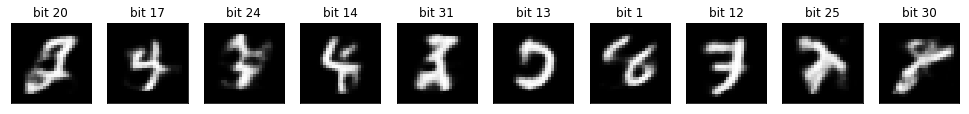

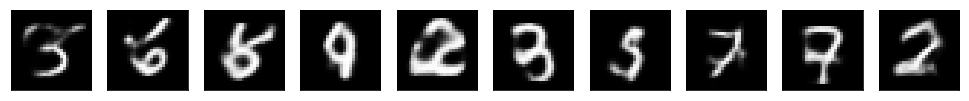

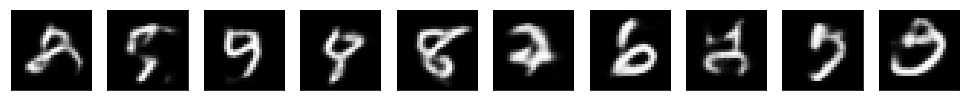

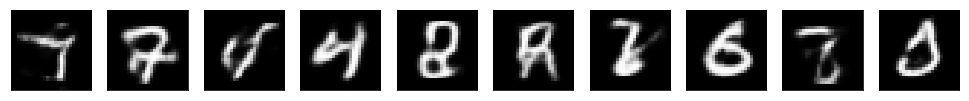

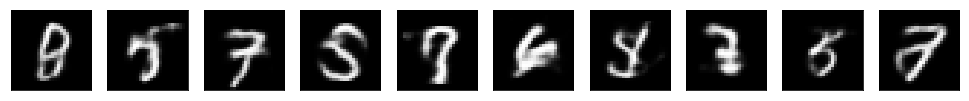

In [287]:
show_generated_imgs(5, 10)

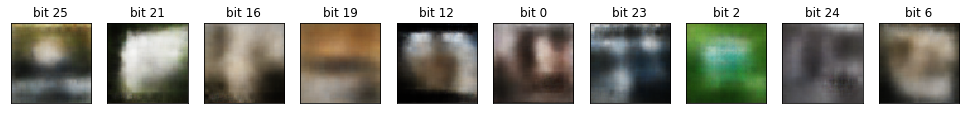

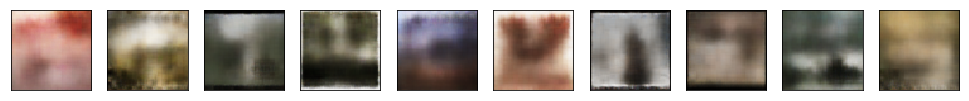

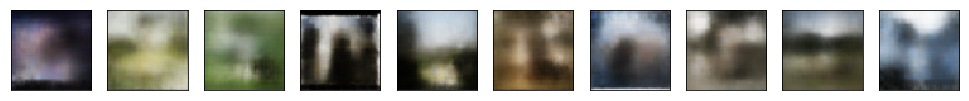

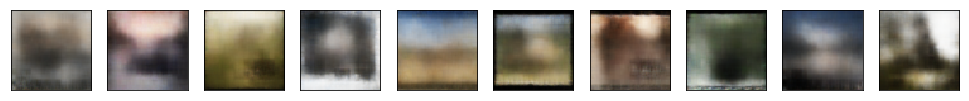

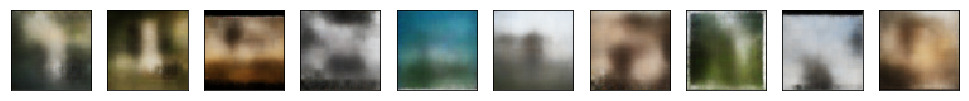

In [25]:
show_generated_imgs(5, 10)

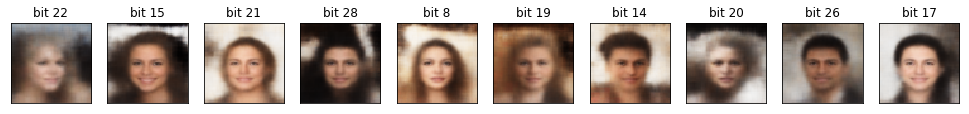

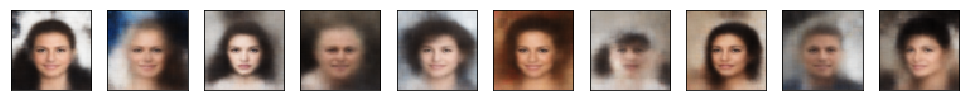

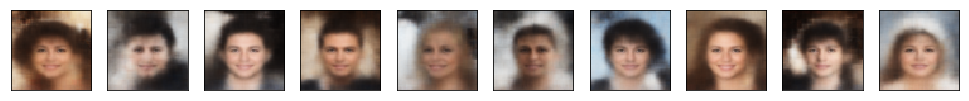

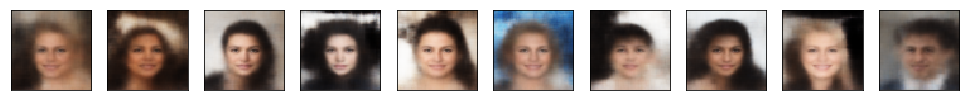

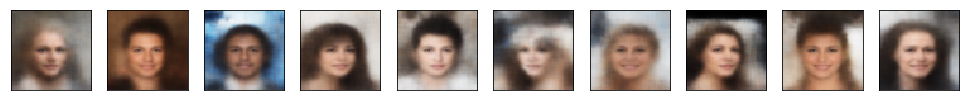

In [57]:
show_generated_imgs(5, 10)

In [58]:
def show_generated_imgs(samplebits, base):
    bits = np.random.choice(np.arange(Nb),samplebits,replace=False) #bits to show

    NB_reconstruct = []
    for i in range(Nb):
        b = np.expand_dims(base, axis=0).copy()
        b[:, i] = 1 #solo un bit con zero 

        reconstruct_data = generator_Bvae.predict(b)[0]
        NB_reconstruct.append(reconstruct_data)
    plt.figure(figsize=(17, 10))
    for i in range(samplebits):
        ax = plt.subplot(1, samplebits,  i + 1)
        I = np.squeeze(NB_reconstruct[bits[i]])

        plt.imshow(I, cmap='gray' if len(I.shape) ==2 else None)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        plt.title("bit "+str(bits[i]) +" on")
    plt.show()
    
     
    NB_reconstruct = []
    for i in range(Nb):
        b = np.expand_dims(base, axis=0).copy()
        b[:, i] = 0 #solo un bit con zero 

        reconstruct_data = generator_Bvae.predict(b)[0]
        NB_reconstruct.append(reconstruct_data)
    plt.figure(figsize=(17, 10))
    for i in range(samplebits):
        ax = plt.subplot(1, samplebits,  i + 1)
        I = np.squeeze(NB_reconstruct[bits[i]])

        plt.imshow(I, cmap='gray' if len(I.shape) ==2 else None)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        plt.title("bit "+str(bits[i])+ " off")
    plt.show()

#### setting base as prior sample

In [61]:
base = np.ones(Nb)*0.5 #prior...
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample prior  -- dato generico (central)

[0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]


[0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5]


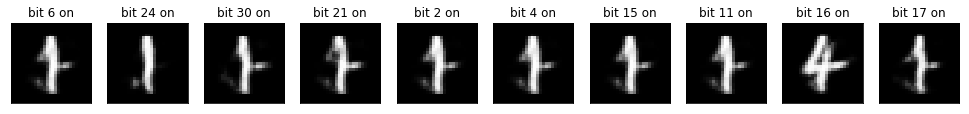

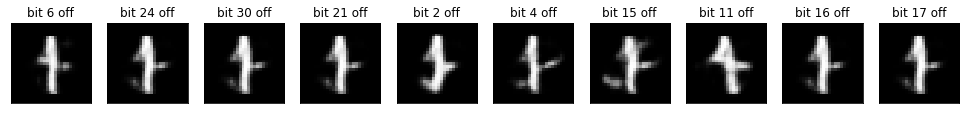

In [139]:
print(name_dat)
show_generated_imgs(10, base=base)

CIFAR-10


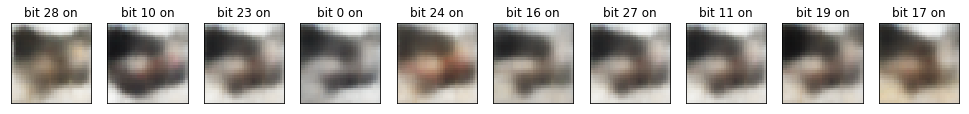

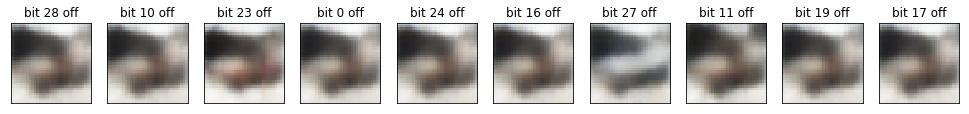

In [59]:
print(name_dat)
show_generated_imgs(10, base=base)

Nus-Wide


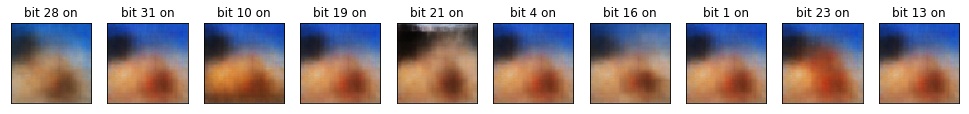

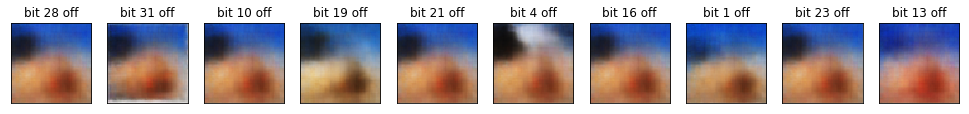

In [30]:
print(name_dat)
show_generated_imgs(10, base=base)

CelebA


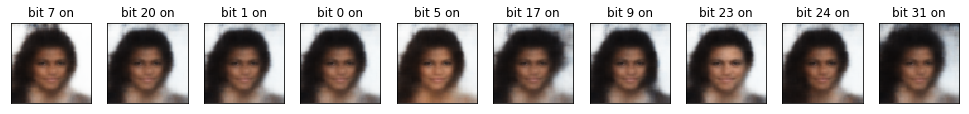

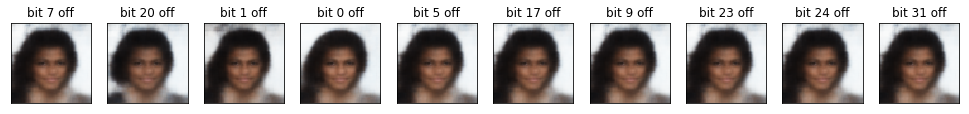

In [62]:
print(name_dat)
show_generated_imgs(10, base=base)

#### setting base as data mean sample -- a litle bit better

In [66]:
base = train_hash.mean(axis=0)
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

[0.3583666  0.42990194 0.4909301  0.55153118 0.52780105 0.57379392
 0.47861605 0.43391536 0.47110936 0.5487278  0.73792824 0.35678422
 0.47356231 0.59316568 0.51653279 0.43127625 0.53293144 0.67693841
 0.56186315 0.40042817 0.53106983 0.47948663 0.5022312  0.50592706
 0.50470058 0.43322547 0.50108686 0.56049431 0.44463608 0.47881316
 0.55891194 0.55529274]


[0.46461667 0.46041667 0.4778     0.44381667 0.48743333 0.52681667
 0.53151667 0.44141667 0.47636667 0.48281667 0.4854     0.52986667
 0.5334     0.48736667 0.4734     0.56156667 0.50998333 0.44993333
 0.65595    0.45253333 0.55261667 0.48718333 0.52573333 0.45515
 0.53683333 0.34546667 0.57838333 0.48926667 0.57013333 0.4838
 0.51286667 0.49828333]


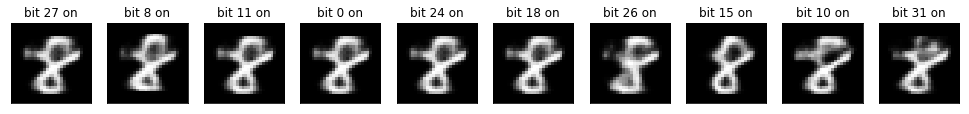

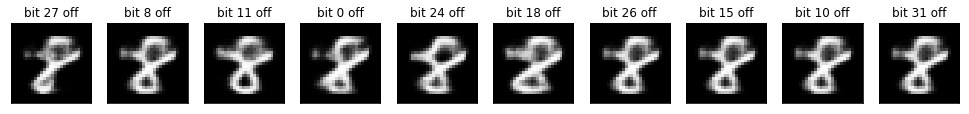

In [140]:
print(name_dat)
show_generated_imgs(10, base=base)

CIFAR-10


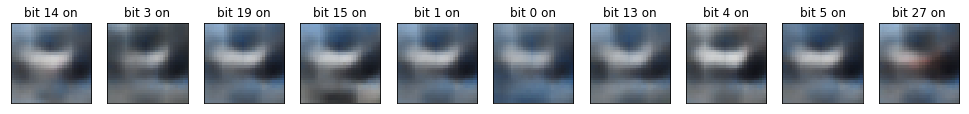

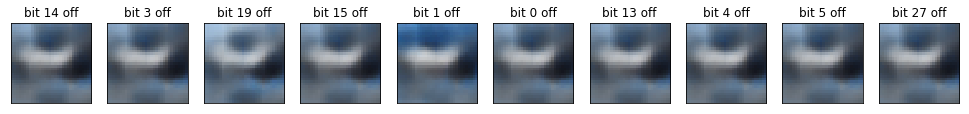

In [61]:
print(name_dat)
show_generated_imgs(10, base=base)

Nus-Wide


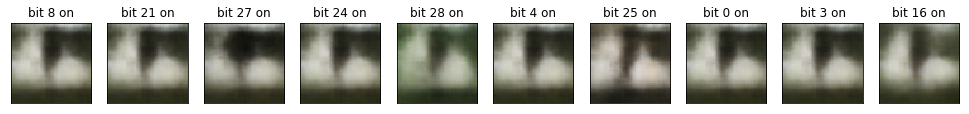

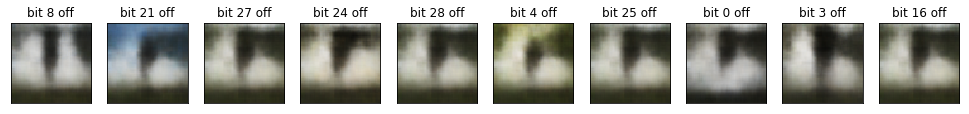

In [41]:
print(name_dat)
show_generated_imgs(10, base=base)

CelebA


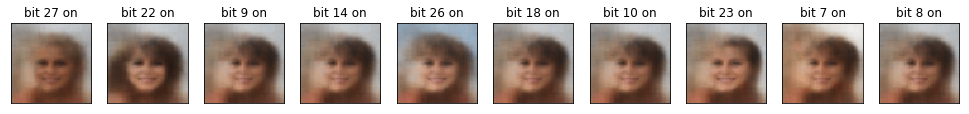

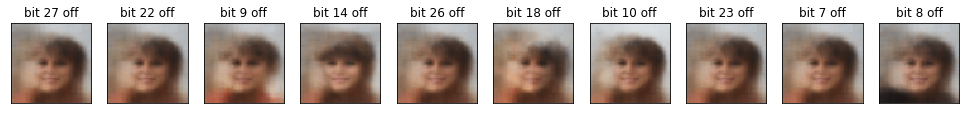

In [64]:
print(name_dat)
show_generated_imgs(10, base=base)

CelebA


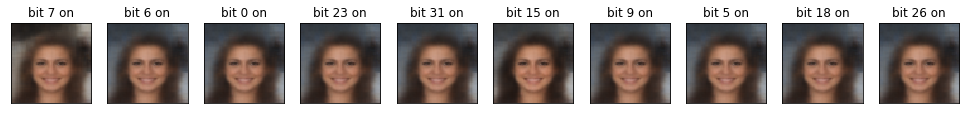

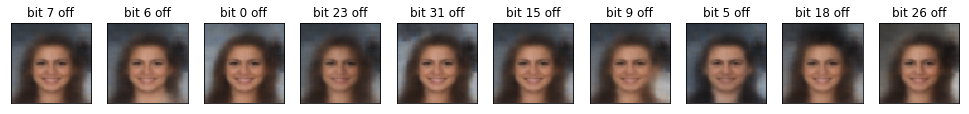

In [69]:
print(name_dat)
show_generated_imgs(10, base=base)

#### setting base as class mean sample

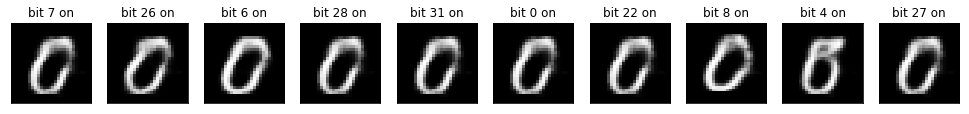

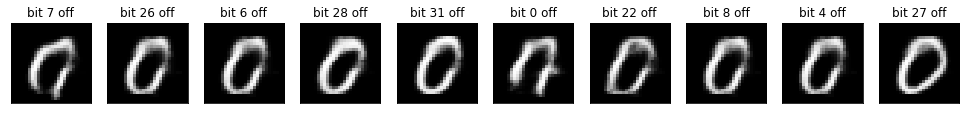

In [141]:
base = train_hash[labels_total=='0'].mean(axis=0) #mean of p(z|y)
base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

[0.30866212 0.4231682  0.70453871 0.11376446 0.56051617 0.43102937
 0.60634826 0.42776624 0.77454761 0.27039454 0.457876   0.95075645
 0.4374073  0.47775141 0.20765352 0.62726194 0.2558588  0.43266093
 0.99792346 0.36695343 0.41723524 0.50845446 0.56363097 0.52818155
 0.99807179 0.95520617 0.70305547 0.18421833 0.43622071 0.62340552
 0.41842183 0.45283299]


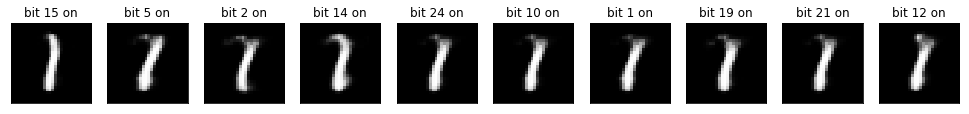

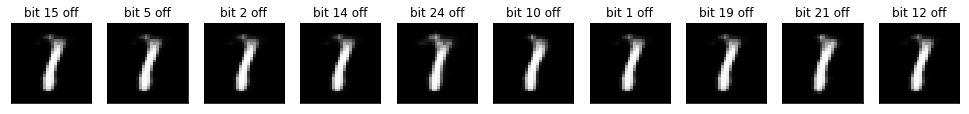

In [148]:
base = train_hash[labels_total=='1'].mean(axis=0) #mean of p(z|y)
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

[0.7363955  0.3713337  0.48662608 0.72735658 0.57258808 0.02600996
 0.43147021 0.47943184 0.56852979 0.6452684  0.6177827  0.41449917
 0.49750968 0.29256595 0.64895776 0.51853901 0.28334256 0.45305294
 0.7048515  0.40472238 0.58402509 0.32134293 0.49714075 0.30916805
 0.2802066  0.2682162  0.82549345 0.57000553 0.63180225 0.71481277
 0.54676259 0.46947058]


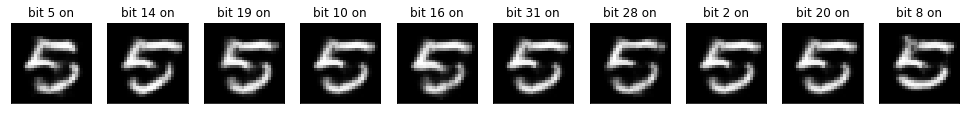

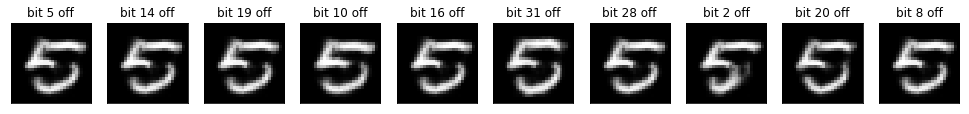

In [144]:
base = train_hash[labels_total=='5'].mean(axis=0) #mean of p(z|y)
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

[0.5254 0.5428 0.4906 0.4502 0.5124 0.8844 0.5718 0.4256 0.3358 0.691
 0.467  0.6028 0.4366 0.5028 0.4644 0.3938 0.5436 0.5162 0.7166 0.7174
 0.5202 0.577  0.4826 0.4082 0.62   0.4326 0.5586 0.5562 0.5246 0.7054
 0.5326 0.4024]


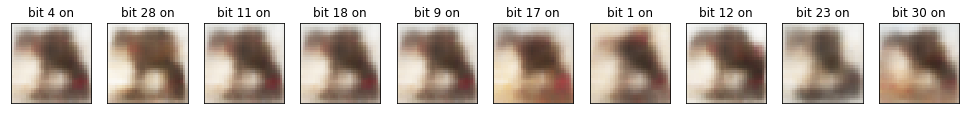

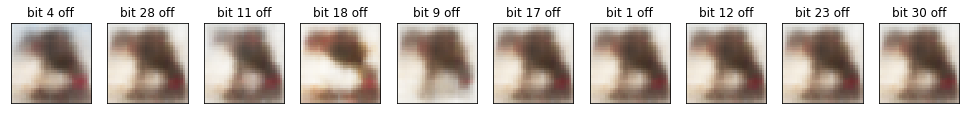

In [84]:
base = train_hash[labels_total=='cat'].mean(axis=0) #mean of p(z|y)
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

[0.4308 0.4544 0.4756 0.3268 0.4926 0.5986 0.547  0.473  0.4994 0.8238
 0.7098 0.693  0.5014 0.3948 0.6228 0.4858 0.3948 0.4524 0.897  0.341
 0.4908 0.5254 0.4712 0.4658 0.5288 0.1142 0.4544 0.5018 0.4228 0.463
 0.4942 0.5916]


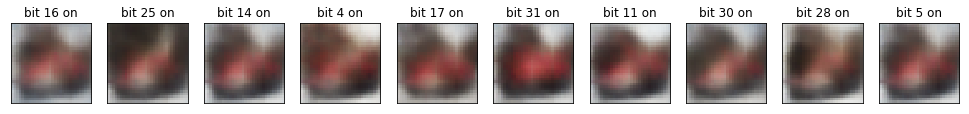

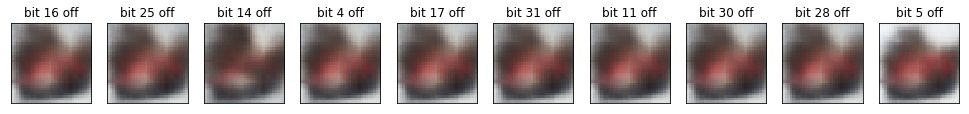

In [169]:
base = train_hash[labels_total=='truck'].mean(axis=0) #mean of p(z|y)
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

[0.485  0.4762 0.5384 0.3066 0.5366 0.7738 0.5136 0.425  0.484  0.7976
 0.6608 0.5642 0.3994 0.3406 0.6366 0.5094 0.4174 0.3866 0.849  0.6056
 0.4908 0.5314 0.5058 0.5538 0.4716 0.3326 0.3928 0.3998 0.3798 0.5314
 0.4016 0.596 ]


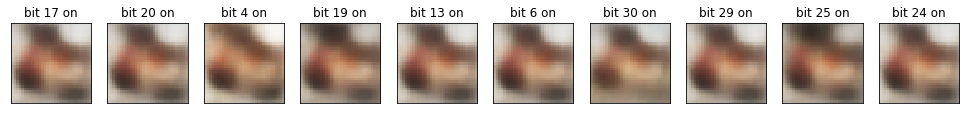

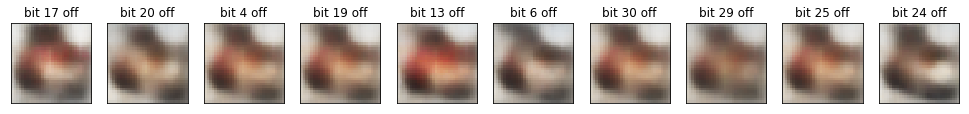

In [170]:
base = train_hash[labels_total=='automobile'].mean(axis=0) #mean of p(z|y)
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

[0.5810786  0.47366928 0.51658293 0.5176178  0.55622507 0.48972643
 0.43794963 0.58308157 0.3762915  0.56956152 0.75249954 0.36145282
 0.53517718 0.42948707 0.56048138 0.50561666 0.56033116 0.26035286
 0.41069253 0.55734339 0.54053513 0.31957403 0.5289012  0.41615062
 0.48982658 0.45647711 0.51997129 0.40171254 0.61087279 0.70823388
 0.46527349 0.59010866]


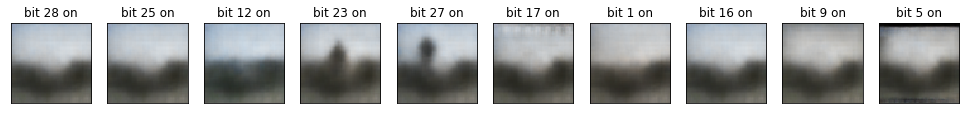

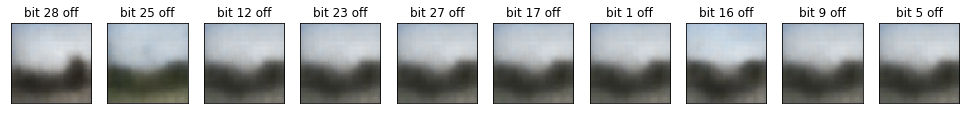

In [86]:
base = train_hash[idx_class['sky']].mean(axis=0) #mean of p(z|y)
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

[0.58757049 0.46012466 0.50539967 0.5209708  0.56092605 0.49295646
 0.46067262 0.57183954 0.32537273 0.57620037 0.76517729 0.35765657
 0.5339163  0.39489486 0.56464759 0.50284253 0.57414553 0.2552798
 0.41297747 0.54320875 0.53450992 0.28749515 0.53715838 0.37758853
 0.46517044 0.47265919 0.50918971 0.36128679 0.61318752 0.70563255
 0.46688281 0.59412315]


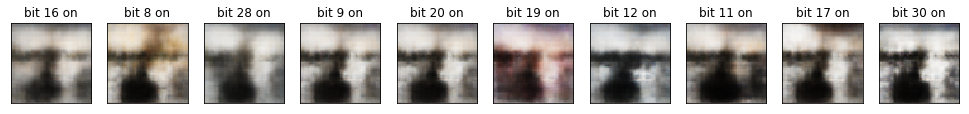

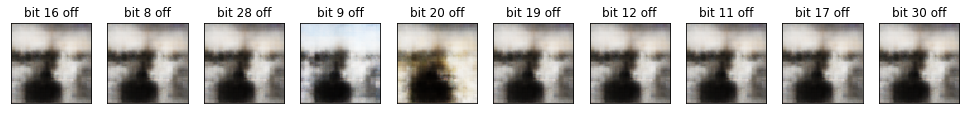

In [127]:
base = train_hash[idx_class['clouds']].mean(axis=0) #mean of p(z|y)
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

[0.6017591  0.50549719 0.51722453 0.56144637 0.53921329 0.48888346
 0.35157586 0.64036159 0.36012705 0.60322502 0.62863425 0.2509162
 0.48912778 0.4070364  0.6117762  0.52992915 0.59711703 0.22428537
 0.40459321 0.5431224  0.54336672 0.29562668 0.48057659 0.3183484
 0.49450281 0.44515026 0.479355   0.3308087  0.62154899 0.54385536
 0.42365013 0.63449792]


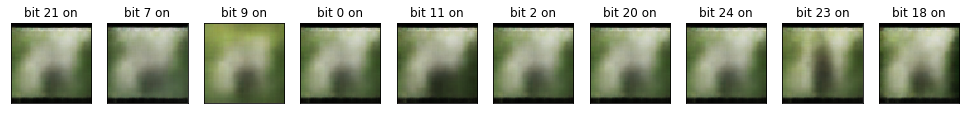

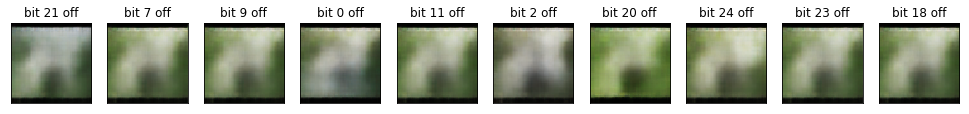

In [253]:
base = train_hash[idx_class['beach']].mean(axis=0) #mean of p(z|y)
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

[0.29398295 0.40987152 0.39066277 0.68477293 0.49548404 0.50756901
 0.36903702 0.43251495 0.52868592 0.47474876 0.6608574  0.2896578
 0.4294619  0.38531993 0.32756647 0.38061315 0.52079888 0.62193105
 0.51698257 0.44103804 0.4232286  0.39193487 0.42831701 0.62116779
 0.3972777  0.23050502 0.53555527 0.13471569 0.29639995 0.40834499
 0.52817708 0.48416232]


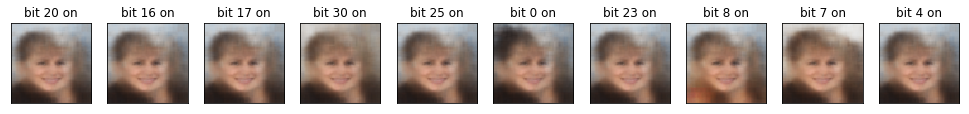

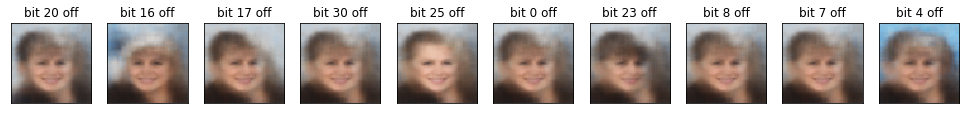

In [79]:
base = train_hash[idx_class['Pale_Skin']].mean(axis=0) #mean of p(z|y)
print(base)

base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

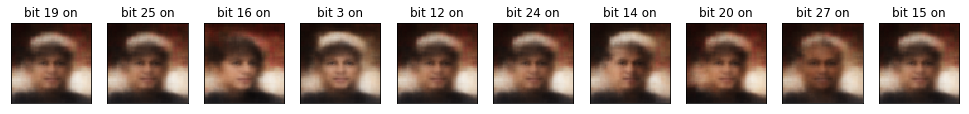

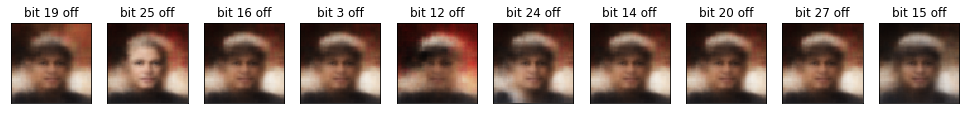

In [97]:
base = train_hash[idx_class['Wearing_Hat']].mean(axis=0) #mean of p(z|y)
base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

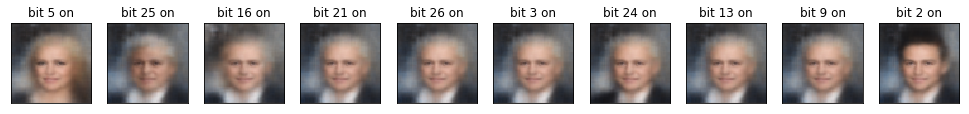

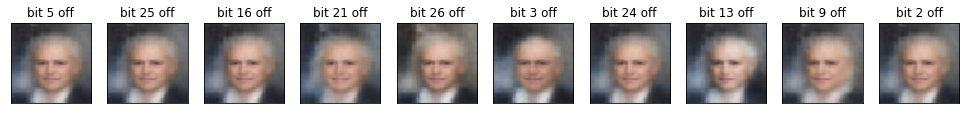

In [142]:
base = train_hash[idx_class['Bald']].mean(axis=0) #mean of p(z|y)
base = np.random.binomial(1,base) #b_hat \sim p(b) sample 

show_generated_imgs(10, base=base)

In [161]:
def show_generated_imgs_class(samplebits, base_class, bits =[]):
    if len(bits) == 0:
        bits = np.random.choice(np.arange(Nb),samplebits,replace=False) #bits to show
    K = len(base_class)
    
    NB_reconstruct = []
    b_rec = []
    for k in range(K):
        aux = []
        for i in range(Nb):
            b = base_class[k].copy()
            b[i] = 1 - b[i] #invertir bit
            aux.append(b)            
        aux = np.asarray(aux)
        NB_reconstruct.append(generator_Bvae.predict(aux))
            
    base_class_reconstruct = generator_Bvae.predict(np.asarray(base_class))
    
    for k in range(K):
        plt.figure(figsize=(17, 50))
        
        ax = plt.subplot(K, samplebits+1, k*(samplebits+1) +1)
        I = np.squeeze(base_class_reconstruct[k])
        plt.imshow(I, cmap='gray' if len(I.shape) ==2 else None)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        #ax.set_title("")
        if k == 0:
            plt.title("Original I")
                
        for i in range(samplebits):
            ax = plt.subplot(K, samplebits+1, k*(samplebits+1) + i + 2)
            I = np.squeeze(NB_reconstruct[k][bits[i]])
            plt.imshow(I, cmap='gray' if len(I.shape) ==2 else None)
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)
            if k == 0:
                plt.title("bit "+str(bits[i]))
    plt.show()

In [151]:
base_class = []

for value in labels:
    if name_dat == "MNIST" or name_dat == "CIFAR-10":
        aux_p = train_hash[labels_total==value].mean(axis=0) #mean of p(z|y)
    else:
        aux_p = train_hash[idx_class[value]].mean(axis=0)
    aux = np.random.binomial(1, aux_p) #b_hat \sim p(b) sample 
    base_class.append(aux)

Nus-Wide


/home/fmena/anaconda3/envs/tesis/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


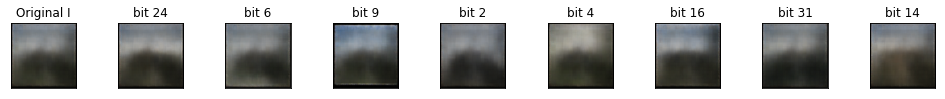

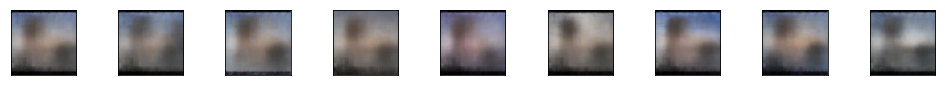

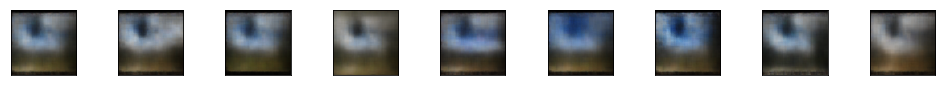

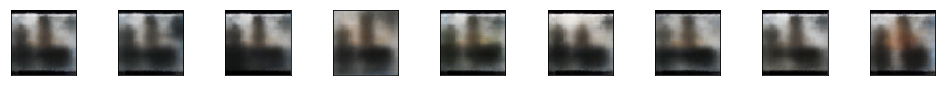

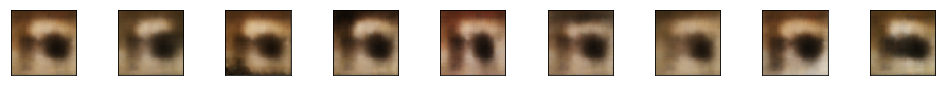

...

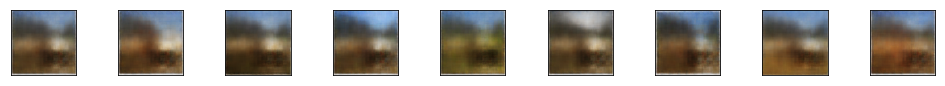

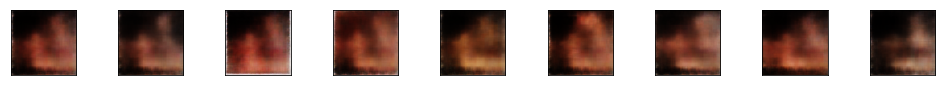

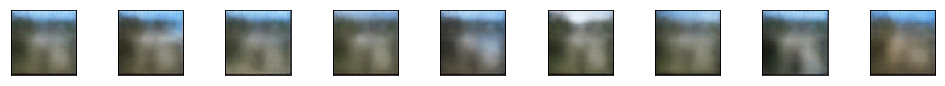

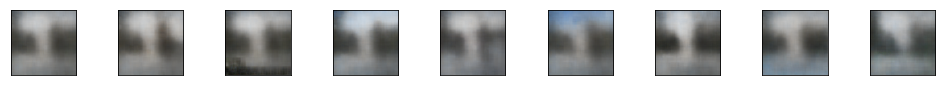

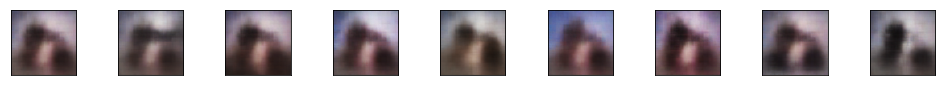

In [276]:
print(name_dat)
show_generated_imgs_class(8, base_class) #bit se invierte.. (para ver el efecto/impacto)

CelebA


/home/fmena/anaconda3/envs/tesis/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


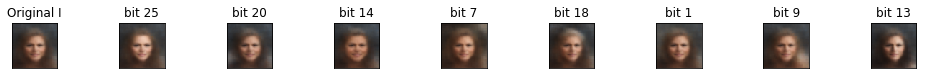

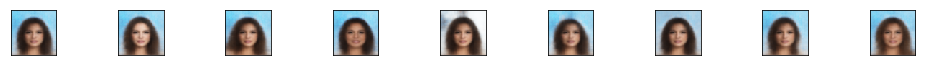

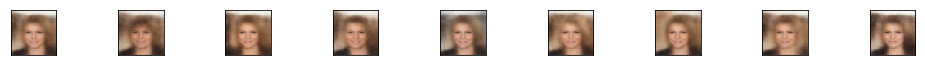

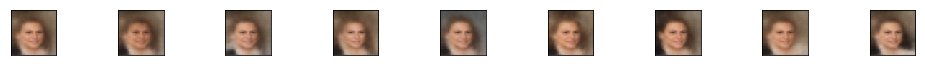

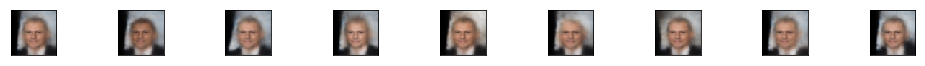

...

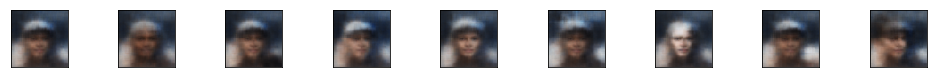

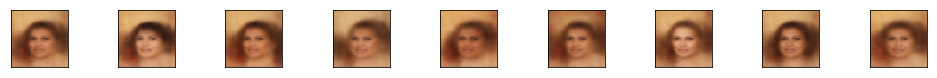

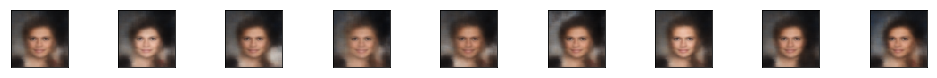

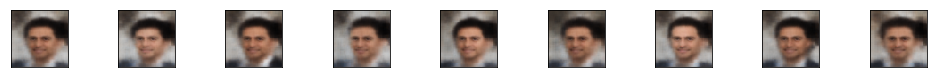

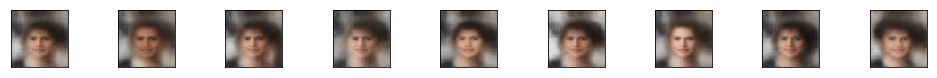

In [152]:
print(name_dat)
show_generated_imgs_class(8, base_class) #bit se invierte.. (para ver el efecto/impacto)

In [162]:
##opcion B, imagen real de esa clase
base_class = []

for value in labels:
    if name_dat == "MNIST" or name_dat == "CIFAR-10":
        idx_samp = np.random.choice(np.where(labels_total==value)[0])
    else:
        idx_samp = np.random.choice(idx_class[value])
    aux = train_hash[idx_samp] #sample object from that class
    base_class.append(aux)

Nus-Wide


/home/fmena/anaconda3/envs/tesis/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


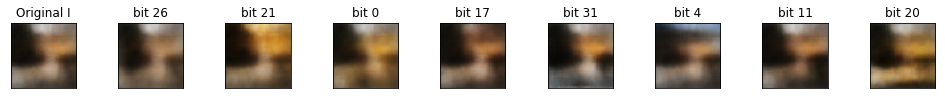

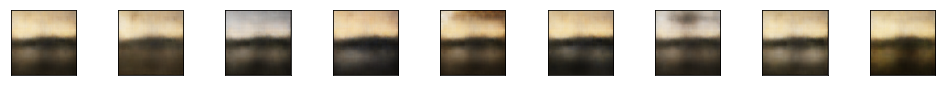

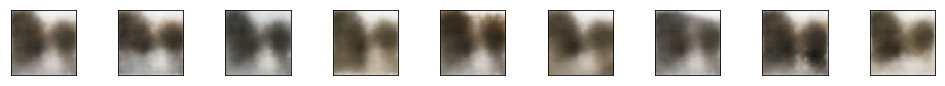

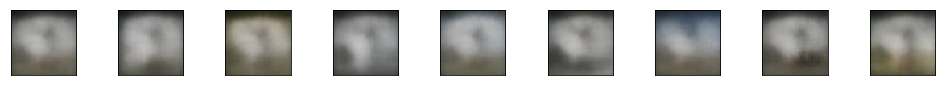

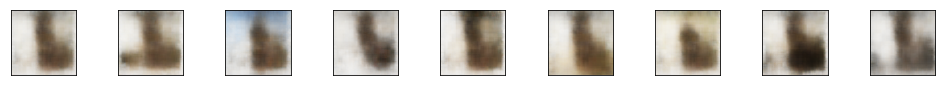

...

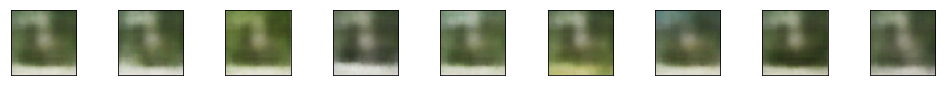

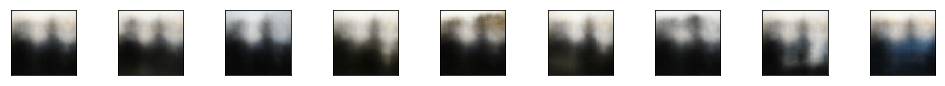

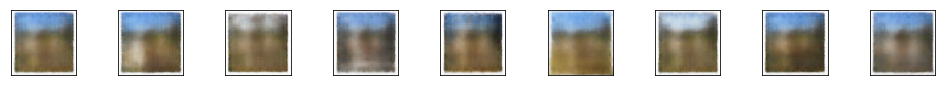

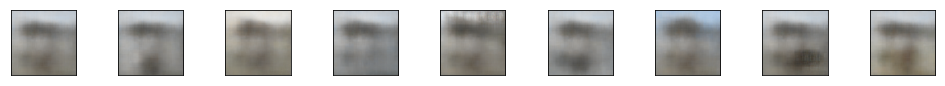

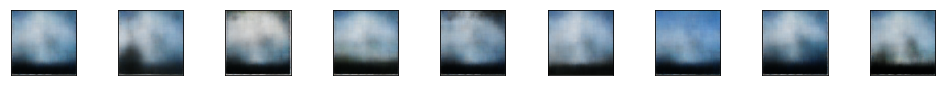

In [311]:
print(name_dat)
show_generated_imgs_class(8, base_class) #bit se invierte.. (para ver el efecto/impacto)

CelebA


/home/fmena/anaconda3/envs/tesis/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


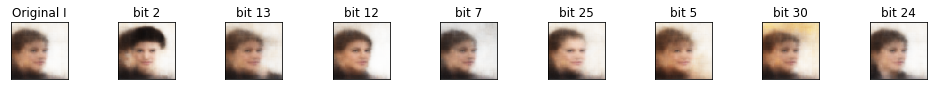

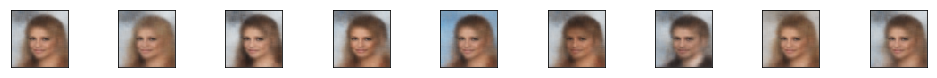

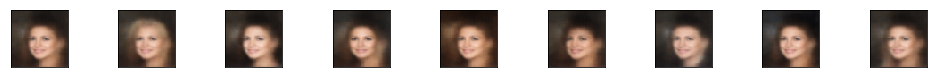

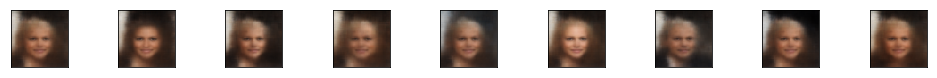

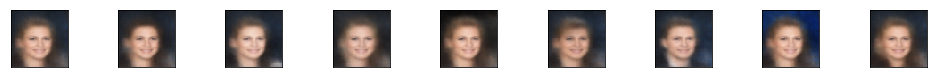

...

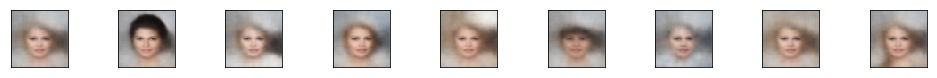

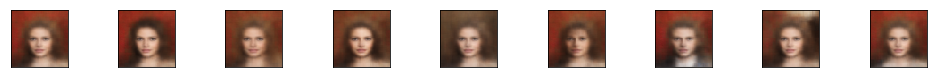

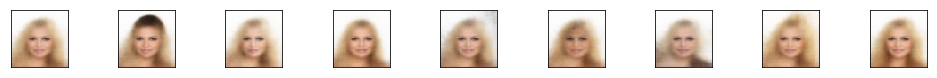

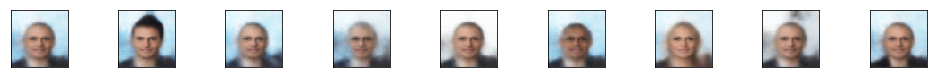

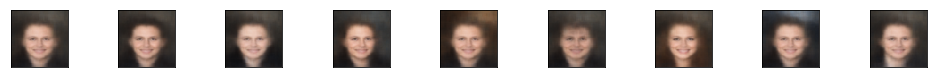

In [160]:
print(name_dat)
show_generated_imgs_class(8, base_class) #bit se invierte.. (para ver el efecto/impacto)

CelebA


/home/fmena/anaconda3/envs/tesis/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


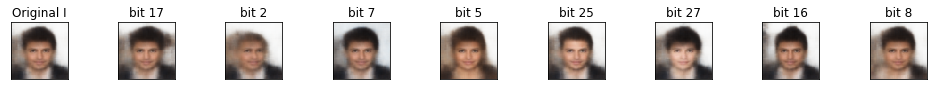

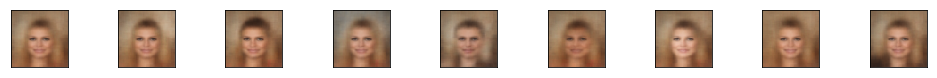

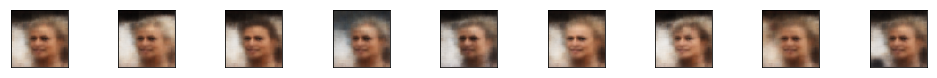

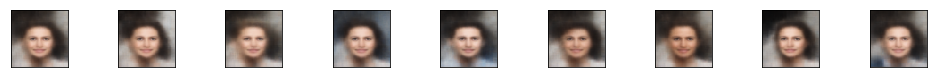

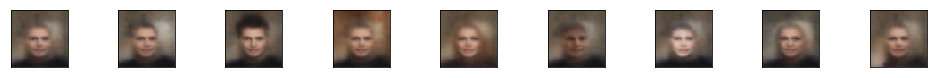

...

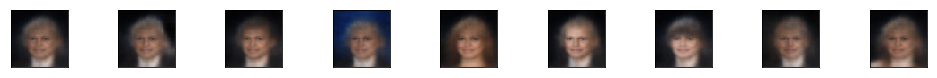

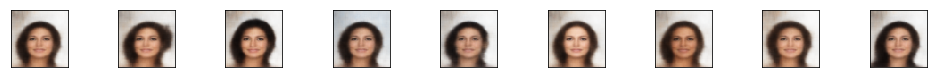

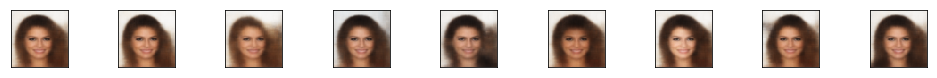

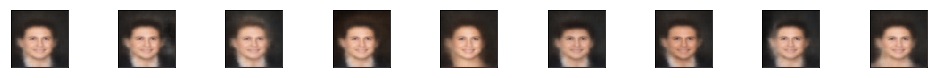

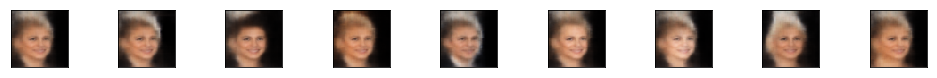

In [163]:
print(name_dat)
show_generated_imgs_class(8, base_class, bits=[17,2,7,5,25,27,16,8]) #bit se invierte.. (para ver el efecto/impacto)

CELEBA:
* Bit 17 mancha
* Bit 2 asociado al cambio de pelo
* Bit 7 asociado al fondo en la imagen
* Bit 5 asociado al cambio de sexo (hombre/mujer)
* Bit 27 asociado a los rasgos étnicos

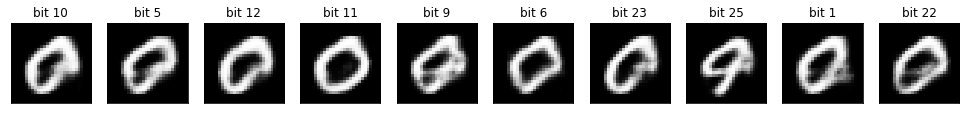

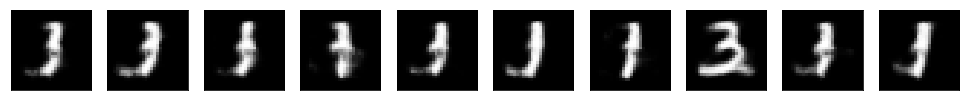

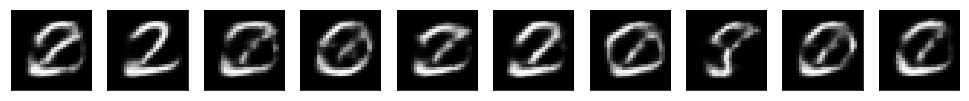

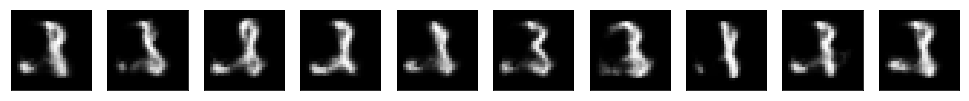

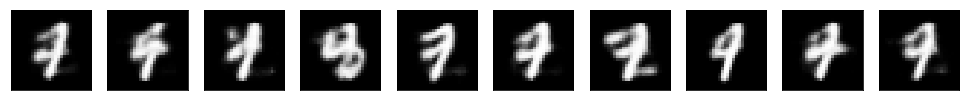

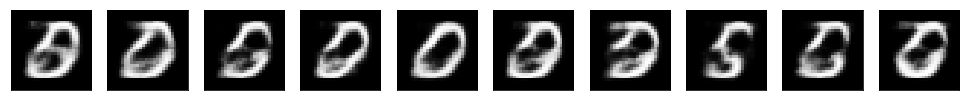

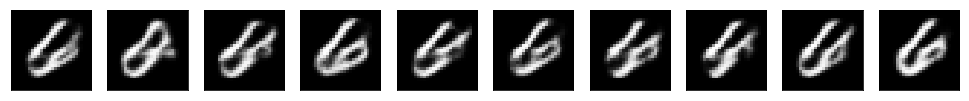

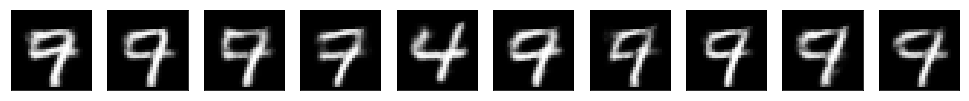

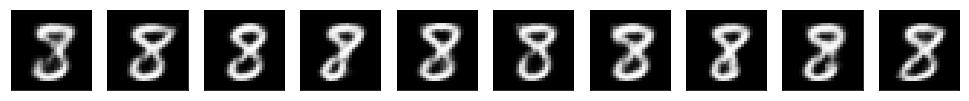

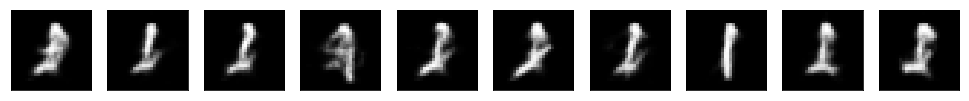

In [149]:
print(name_dat)
show_generated_imgs_class(10, base_class) #bit se invierte.. (para ver el efecto/impacto)

Bit 25 define claramente la clase 1, al cambiarlo  el valor se transforma en 3 (o define la transición entre 1 y 3), ocurre lo mismo entre el 0 y 9. 

CIFAR-10


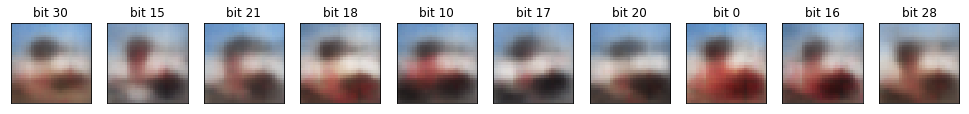

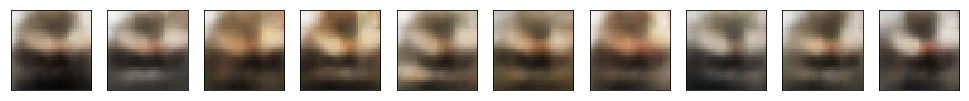

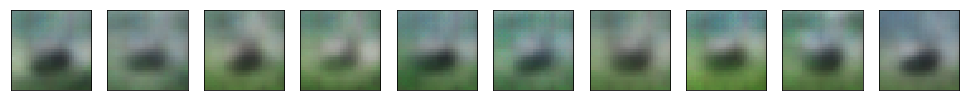

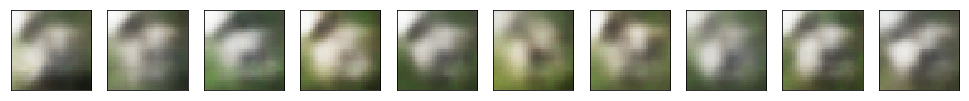

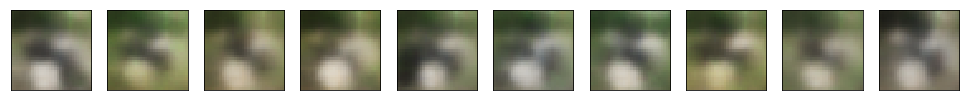

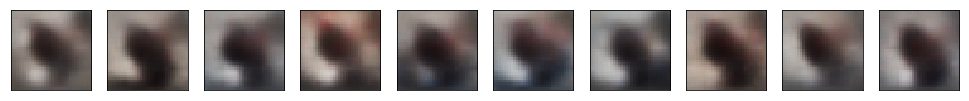

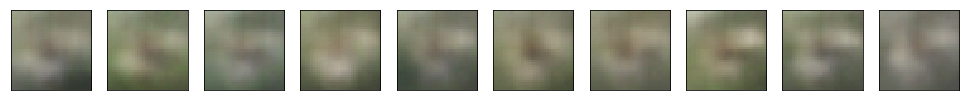

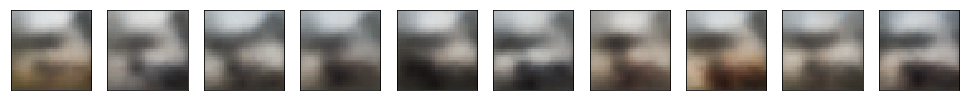

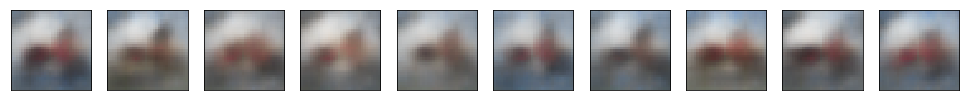

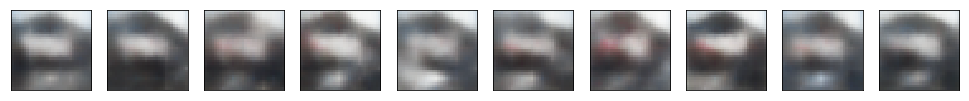

In [180]:
print(name_dat)
show_generated_imgs_class(10, base_class) #bit se invierte.. (para ver el efecto/impacto)

In [164]:
#https://github.com/Schlumberger/joint-vae
    
def img_editing(samplebits, img_code):
    bits = np.random.choice(np.arange(Nb),samplebits,replace=False)

    base = np.expand_dims(img_code, axis=0)
    I = generator_Bvae.predict(base)[0]
    plt.imshow(np.squeeze(I))
    plt.show()
        
    bs_1 = np.tile(base, (Nb,1))
    bs_0 = np.tile(base, (Nb,1))
    for i in range(Nb):        
        bs_1[i,i] = 1 #solo un bit activado 
        bs_0[i,i] = 0 #apagado 
    NB_reconstruct_1 = generator_Bvae.predict(bs_1)
    NB_reconstruct_0 = generator_Bvae.predict(bs_0)
    
    plt.figure(figsize=(17, 10))
    for i in range(samplebits):
        ax = plt.subplot(2, samplebits, i + 1)
        I = np.squeeze(NB_reconstruct_1[bits[i]])
        plt.imshow(I, cmap='gray' if len(I.shape) ==2 else None)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        plt.title("bit "+str(bits[i]))
            
    plt.figure(figsize=(17, 10))
    for i in range(samplebits):
        ax = plt.subplot(2, samplebits, samplebits + i + 1)
        I = np.squeeze(NB_reconstruct_0[bits[i]])
        plt.imshow(I, cmap='gray' if len(I.shape) ==2 else None)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.show()

In [165]:
b_samp = train_hash[np.random.choice(len(train_hash))] #sampled data
b_samp

array([0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 1])

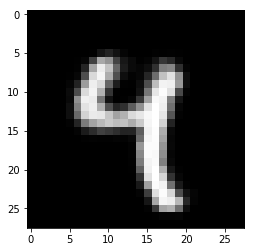

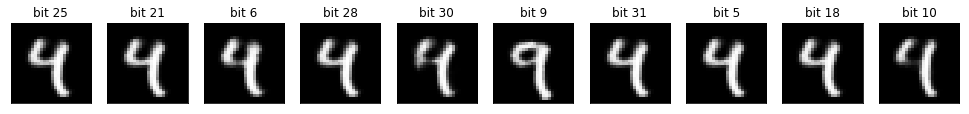

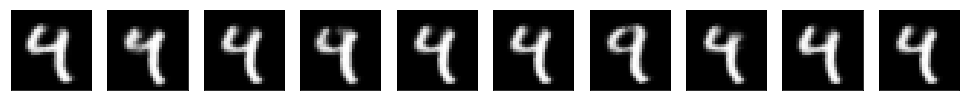

In [277]:
img_editing(10, img_code=b_samp) #variacion solo es apagado o encendido

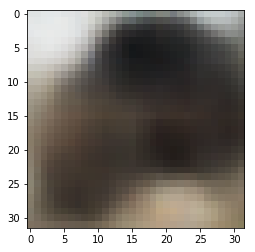

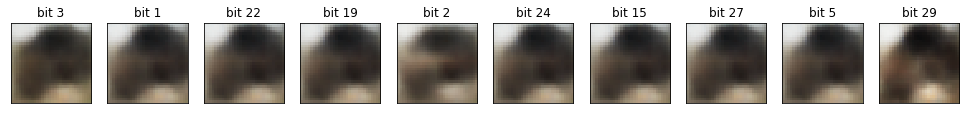

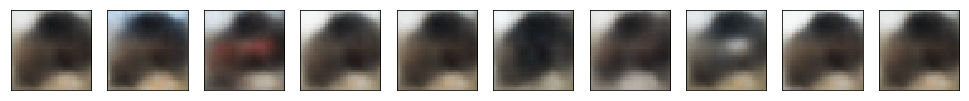

In [210]:
img_editing(10, img_code=b_samp) #variacion solo es apagado o encendido

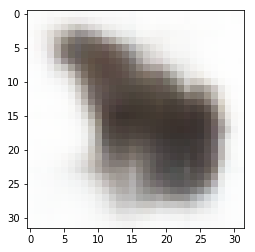

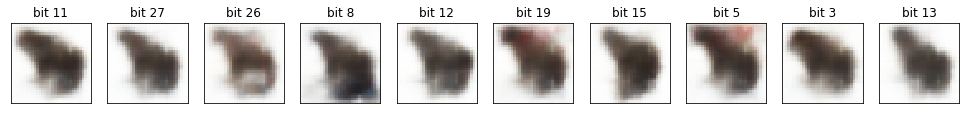

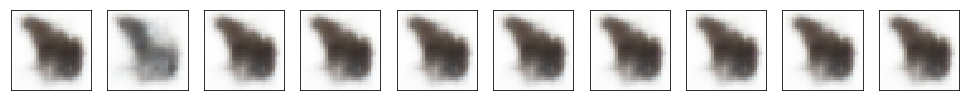

In [253]:
img_editing(10, img_code=b_samp) #variacion solo es apagado o encendido

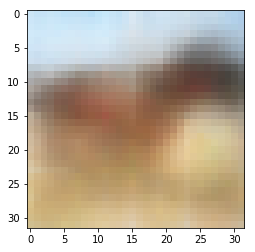

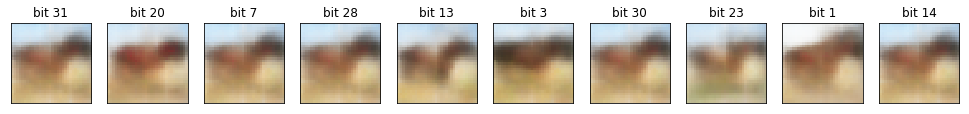

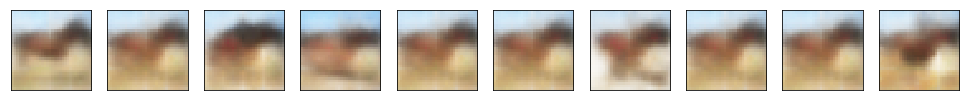

In [286]:
img_editing(10, img_code=b_samp) #variacion solo es apagado o encendido

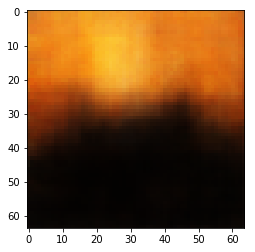

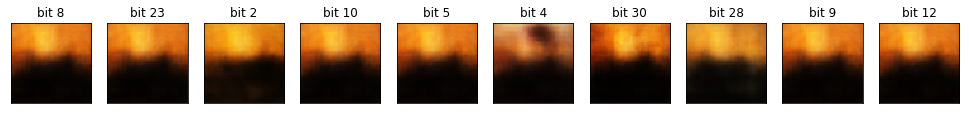

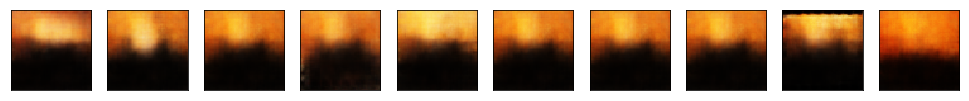

In [318]:
img_editing(10, img_code=b_samp) #variacion solo es apagado o encendido

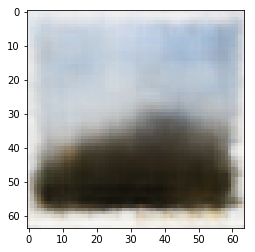

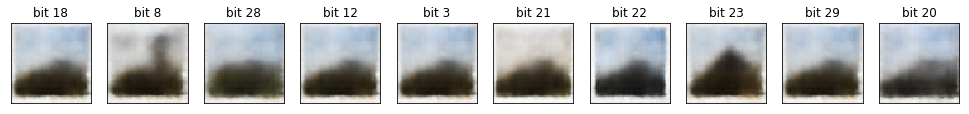

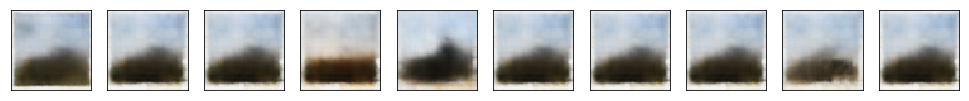

In [319]:
img_editing(10, img_code=b_samp) #variacion solo es apagado o encendido

La idea de todo lo anterior es buscar visualizar qué variación provoca cada bit.

In [205]:
def img_editing_2bits(img_code, bits =[]):    
    if len(bits) == 0:
        bits = np.random.choice(np.arange(Nb),2,replace=False)
    base = img_code

    bs = np.tile(base, (4,1))
    true_pos = 99999
    for i in range(2):
        for j in range(2):
            bs[i+j][bits[0]] = i
            bs[i+j][bits[1]] = j 
            if np.sum(bs[i+j] != base) == 0:
                true_pos = i+j
            
    NB_reconstruct = generator_Bvae.predict(bs)
    
    f, axx = plt.subplots(2,2, figsize=(10,10))
    for i in range(2):
        for j in range(2):    
            I = np.squeeze(NB_reconstruct[i+j])
            axx[i,j].imshow(I, cmap='gray' if len(I.shape) ==2 else None)
            axx[i,j].set_xticks([]) #get_xaxis().set_visible(False)
            axx[i,j].set_yticks([]) #get_yaxis().set_visible(False)
            
            if i == 0:
                axx[i,j].set_title("Bit "+str(bits[0])+ " is "+ str(j))
                
            if j==0:
                axx[i,j].set_ylabel("Bit "+str(bits[1])+ " is "+ str(i))
                
            if i+j==true_pos:
                axx[i,j].set_xlabel("Original img")
                    
    plt.show()
    

In [167]:
b_samp = train_hash[np.random.choice(len(train_hash))] #sampled data

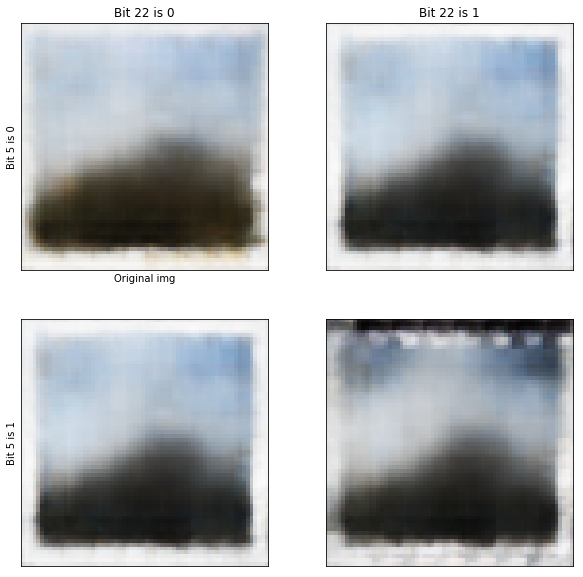

In [386]:
img_editing_2bits(b_samp)

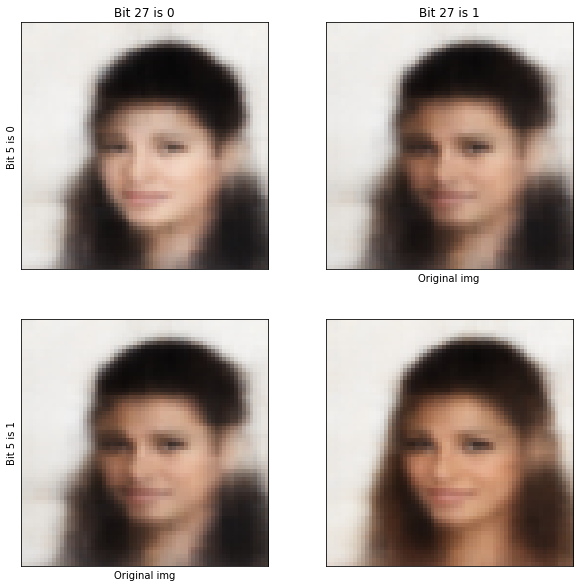

In [188]:
b_samp = train_hash[np.random.choice(len(train_hash))] #sampled data
img_editing_2bits(b_samp)

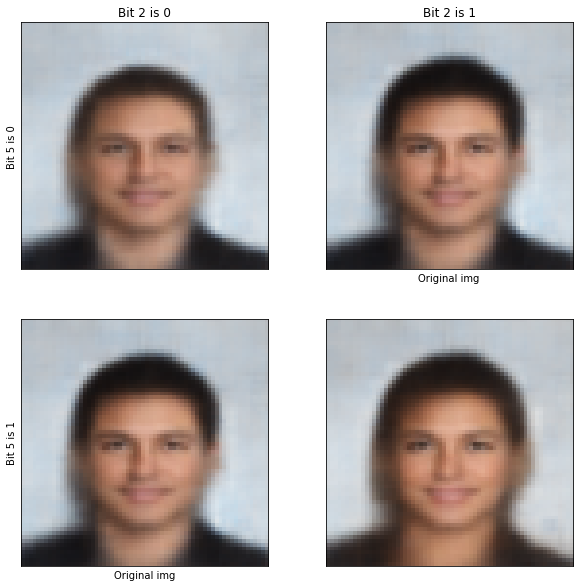

In [215]:
b_samp = train_hash[np.random.choice(len(train_hash))] #sampled data
img_editing_2bits(b_samp, bits=[2,5])

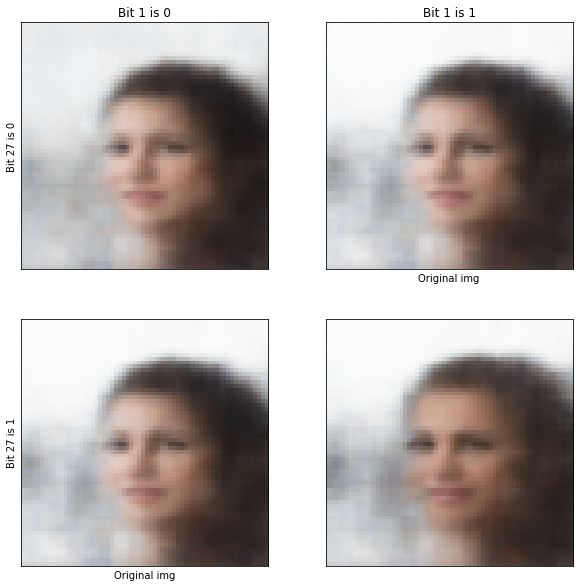

In [235]:
b_samp = train_hash[np.random.choice(len(train_hash))] #sampled data
img_editing_2bits(b_samp, bits=[1,27])